# Quo Vadis Covid-19?

In [1]:
import warnings
warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import seaborn as sns
from sklearn import preprocessing

import plotly.express as px # https://plotly.com/python/
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

import altair as alt
!pip install altair_saver
from altair_saver import save
import altair_saver


import requests
import sys

#!pip install statsmodels
from statsmodels.tsa.seasonal import seasonal_decompose # Seasonal decomposition method (classic)

# Forecasting Model
#!pip install fbprophet
import fbprophet #print('Prophet %s' % fbprophet.__version__)
from fbprophet import Prophet
from fbprophet.plot import add_changepoints_to_plot # Adding likely spikes that change the trend

!pip install pillow
from PIL import Image

# Analisis supervisado
from sklearn.model_selection import train_test_split

# Metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

# Decision tree method
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.tree import plot_tree

# KNeighborsClassifier, Naive Bayes, Stochastic Gradient Descendent Classifier, Random Forest
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier # one vs all multiclass
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression

# Time Series Clustering
!pip install tslearn
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from tslearn.preprocessing import TimeSeriesResampler, \
    TimeSeriesResampler

# Time series KMeans
from tslearn.clustering import TimeSeriesKMeans

#  Preprocessing for numbering categorical series 
from sklearn import preprocessing

     |████████████████████████████████| 92kB 2.4MB/s 
     |████████████████████████████████| 911kB 8.2MB/s 
     |████████████████████████████████| 563kB 15.4MB/s 
     |████████████████████████████████| 778kB 2.7MB/s 


In [2]:
url = 'https://docs.google.com/spreadsheets/d/16-bnsDdmmgtSxdWbVMboIHo5FRuz76DBxsz_BbsEVWA/export?format=csv&id=16-bnsDdmmgtSxdWbVMboIHo5FRuz76DBxsz_BbsEVWA&gid=0'
df_historico = pd.read_csv(url)
df_historico.head()

,fecha,dia_inicio,dia_cuarentena_dnu260,osm_admin_level_2,osm_admin_level_4,osm_admin_level_8,tot_casosconf,nue_casosconf_diff,tot_fallecidos,nue_fallecidos_diff,tot_recuperados,tot_terapia,test_RT-PCR_negativos,test_RT-PCR_total,transmision_tipo,informe_tipo,informe_link,observacion,covid19argentina_admin_level_4
0,2/03/2020,1,NaN,Argentina,CABA,NaN,1,1.0,0,0.0,NaN,NaN,NaN,NaN,importado,NaN,https://www.infobae.com/coronavirus/2020/03/03...,no hay informe,capital-federal
1,3/03/2020,2,NaN,Argentina,Indeterminado,NaN,1,0.0,0,0.0,NaN,NaN,NaN,NaN,importado,NaN,NaN,no hay informe,no-data
2,4/03/2020,3,NaN,Argentina,Indeterminado,NaN,1,0.0,0,0.0,NaN,NaN,NaN,NaN,importado,NaN,NaN,no hay informe,no-data
3,5/03/2020,4,NaN,Argentina,Buenos Aires,NaN,2,1.0,2,2.0,NaN,NaN,NaN,NaN,importado,informe nacional,https://www.argentina.gob.ar/sites/default/fil...,NaN,buenos-aires
4,6/03/2020,5,NaN,Argentina,Indeterminado,NaN,2,0.0,2,0.0,NaN,NaN,NaN,NaN,importado,informe nacional,https://www.argentina.gob.ar/sites/default/fil...,NaN,no-data


In [3]:
df_historico.fillna(0)

,fecha,dia_inicio,dia_cuarentena_dnu260,osm_admin_level_2,osm_admin_level_4,osm_admin_level_8,tot_casosconf,nue_casosconf_diff,tot_fallecidos,nue_fallecidos_diff,tot_recuperados,tot_terapia,test_RT-PCR_negativos,test_RT-PCR_total,transmision_tipo,informe_tipo,informe_link,observacion,covid19argentina_admin_level_4
0,2/03/2020,1,0.0,Argentina,CABA,0,1,1.0,0,0.0,0,0.0,0.0,0.0,importado,0,https://www.infobae.com/coronavirus/2020/03/03...,no hay informe,capital-federal
1,3/03/2020,2,0.0,Argentina,Indeterminado,0,1,0.0,0,0.0,0,0.0,0.0,0.0,importado,0,0,no hay informe,no-data
2,4/03/2020,3,0.0,Argentina,Indeterminado,0,1,0.0,0,0.0,0,0.0,0.0,0.0,importado,0,0,no hay informe,no-data
3,5/03/2020,4,0.0,Argentina,Buenos Aires,0,2,1.0,2,2.0,0,0.0,0.0,0.0,importado,informe nacional,https://www.argentina.gob.ar/sites/default/fil...,0,buenos-aires
4,6/03/2020,5,0.0,Argentina,Indeterminado,0,2,0.0,2,0.0,0,0.0,0.0,0.0,importado,informe nacional,https://www.argentina.gob.ar/sites/default/fil...,0,no-data
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4862,1/11/2020,242,0.0,0,Santa Fe,0,1166924,0.0,31002,0.0,0,0.0,0.0,0.0,0,0,0,0,0
4863,1/11/2020,242,0.0,0,Santiago del Estero,0,1166924,0.0,31002,0.0,0,0.0,0.0,0.0,0,0,0,0,0
4864,1/11/2020,242,0.0,0,Tierra del Fuego,0,1166924,0.0,31002,0.0,0,0.0,0.0,0.0,0,0,0,0,0
4865,1/11/2020,242,0.0,0,Tucumán,0,1166924,0.0,31002,0.0,0,0.0,0.0,0.0,0,0,0,0,0


In [4]:
df_historico = df_historico[['fecha','osm_admin_level_4','nue_casosconf_diff','nue_fallecidos_diff']]
df_historico.head()

,fecha,osm_admin_level_4,nue_casosconf_diff,nue_fallecidos_diff
0,2/03/2020,CABA,1.0,0.0
1,3/03/2020,Indeterminado,0.0,0.0
2,4/03/2020,Indeterminado,0.0,0.0
3,5/03/2020,Buenos Aires,1.0,2.0
4,6/03/2020,Indeterminado,0.0,0.0


In [5]:
# Deleting Indeterminate and NA (sure indeterminado is not transformed in NA?)
df_historico.drop(df_historico[df_historico.osm_admin_level_4 == 'Indeterminado'].index, inplace=True)
df_historico.drop(df_historico[df_historico.osm_admin_level_4.isna()].index, inplace=True)
df_historico.head()

,fecha,osm_admin_level_4,nue_casosconf_diff,nue_fallecidos_diff
0,2/03/2020,CABA,1.0,0.0
3,5/03/2020,Buenos Aires,1.0,2.0
6,8/03/2020,Buenos Aires,8.0,0.0
7,9/03/2020,CABA,1.0,1.0
8,9/03/2020,San Luis,2.0,0.0


In [6]:
df_historico.fecha = pd.to_datetime(df_historico.fecha.astype(str), format='%d/%m/%Y')


In [7]:
df_historico.rename(columns={
    'fecha':'index',
    'osm_admin_level_4':'Province/State'
}, inplace=True)

In [8]:
df_historico.head()

,index,Province/State,nue_casosconf_diff,nue_fallecidos_diff
0,2020-03-02,CABA,1.0,0.0
3,2020-03-05,Buenos Aires,1.0,2.0
6,2020-03-08,Buenos Aires,8.0,0.0
7,2020-03-09,CABA,1.0,1.0
8,2020-03-09,San Luis,2.0,0.0


In [9]:
df_historico.sort_values(by=['Province/State', 'index'], ascending=True).head()

,index,Province/State,nue_casosconf_diff,nue_fallecidos_diff
3,2020-03-05,Buenos Aires,1.0,2.0
6,2020-03-08,Buenos Aires,8.0,0.0
11,2020-03-10,Buenos Aires,1.0,0.0
13,2020-03-11,Buenos Aires,1.0,0.0
16,2020-03-13,Buenos Aires,1.0,0.0


In [10]:
df_historico.head()

,index,Province/State,nue_casosconf_diff,nue_fallecidos_diff
0,2020-03-02,CABA,1.0,0.0
3,2020-03-05,Buenos Aires,1.0,2.0
6,2020-03-08,Buenos Aires,8.0,0.0
7,2020-03-09,CABA,1.0,1.0
8,2020-03-09,San Luis,2.0,0.0


In [11]:
df_deaths = df_historico[['index','Province/State','nue_fallecidos_diff']]
df_confirmed = df_historico[['index','Province/State','nue_casosconf_diff']]

In [12]:
df_deaths.head()

,index,Province/State,nue_fallecidos_diff
0,2020-03-02,CABA,0.0
3,2020-03-05,Buenos Aires,2.0
6,2020-03-08,Buenos Aires,0.0
7,2020-03-09,CABA,1.0
8,2020-03-09,San Luis,0.0


In [13]:
df_confirmed.head(5)

,index,Province/State,nue_casosconf_diff
0,2020-03-02,CABA,1.0
3,2020-03-05,Buenos Aires,1.0
6,2020-03-08,Buenos Aires,8.0
7,2020-03-09,CABA,1.0
8,2020-03-09,San Luis,2.0


In [14]:
df_confirmed.groupby(['index','Province/State'])['nue_casosconf_diff'].sum().reset_index().head()

,index,Province/State,nue_casosconf_diff
0,2020-03-02,CABA,1.0
1,2020-03-05,Buenos Aires,1.0
2,2020-03-08,Buenos Aires,8.0
3,2020-03-09,CABA,1.0
4,2020-03-09,Chaco,5.0


In [15]:
df_confirmed.head()

,index,Province/State,nue_casosconf_diff
0,2020-03-02,CABA,1.0
3,2020-03-05,Buenos Aires,1.0
6,2020-03-08,Buenos Aires,8.0
7,2020-03-09,CABA,1.0
8,2020-03-09,San Luis,2.0


In [16]:
df_confirmed_pivot = pd.pivot_table(df_confirmed, values='nue_casosconf_diff', index=['Province/State'], columns='index', aggfunc=np.sum).fillna(0)
df_confirmed_pivot.head()

index,2020-03-02,2020-03-05,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-03-28,2020-03-29,2020-03-30,2020-03-31,2020-04-01,2020-04-02,2020-04-03,2020-04-04,2020-04-05,2020-04-06,2020-04-07,2020-04-08,2020-04-09,2020-04-10,2020-04-11,2020-04-12,2020-04-13,2020-04-14,...,2020-09-23,2020-09-24,2020-09-25,2020-09-26,2020-09-27,2020-09-28,2020-09-29,2020-09-30,2020-10-01,2020-10-02,2020-10-03,2020-10-04,2020-10-05,2020-10-06,2020-10-07,2020-10-08,2020-10-09,2020-10-10,2020-10-11,2020-10-12,2020-10-13,2020-10-14,2020-10-15,2020-10-16,2020-10-17,2020-10-18,2020-10-19,2020-10-20,2020-10-21,2020-10-22,2020-10-23,2020-10-24,2020-10-25,2020-10-26,2020-10-27,2020-10-28,2020-10-29,2020-10-30,2020-10-31,2020-11-01
Province/State,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Buenos Aires,0.0,1.0,8.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,6.0,14.0,9.0,14.0,8.0,5.0,29.0,30.0,27.0,36.0,8.0,16.0,36.0,17.0,10.0,36.0,22.0,26.0,33.0,12.0,34.0,17.0,28.0,19.0,37.0,28.0,29.0,66.0,...,5389.0,6122.0,5600.0,4480.0,2947.0,4544.0,5328.0,5943.0,5407.0,5695.0,4507.0,2648.0,4471.0,5659.0,5222.0,5184.0,5346.0,4074.0,2542.0,2221.0,4666.0,5175.0,5756.0,5199.0,4419.0,2383.0,4206.0,4981.0,5179.0,4854.0,4649.0,3030.0,2170.0,3694.0,4221.0,4238.0,3708.0,3830.0,2354.0,0.0
CABA,1.0,0.0,0.0,1.0,1.0,1.0,10.0,2.0,11.0,6.0,5.0,4.0,10.0,8.0,9.0,29.0,11.0,11.0,29.0,21.0,30.0,27.0,18.0,13.0,34.0,19.0,10.0,24.0,28.0,34.0,32.0,17.0,24.0,18.0,23.0,11.0,46.0,8.0,10.0,22.0,...,929.0,1009.0,926.0,917.0,628.0,787.0,993.0,898.0,924.0,1050.0,801.0,533.0,684.0,883.0,956.0,937.0,874.0,742.0,642.0,499.0,745.0,825.0,830.0,952.0,610.0,517.0,557.0,663.0,740.0,566.0,585.0,464.0,445.0,515.0,598.0,641.0,512.0,504.0,441.0,0.0
Catamarca,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,2.0,6.0,4.0,67.0,3.0,4.0,8.0,5.0,7.0,6.0,13.0,0.0,9.0,8.0,18.0,7.0,10.0,6.0,14.0,3.0,8.0,6.0,22.0,24.0,27.0,12.0,8.0,25.0,27.0,11.0,33.0,35.0,7.0,28.0,54.0,16.0,83.0,77.0,0.0
Chaco,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,4.0,3.0,1.0,1.0,2.0,1.0,5.0,7.0,4.0,9.0,12.0,3.0,3.0,5.0,4.0,12.0,3.0,12.0,3.0,8.0,8.0,0.0,4.0,4.0,15.0,6.0,5.0,0.0,1.0,3.0,31.0,...,86.0,128.0,120.0,160.0,111.0,65.0,143.0,157.0,200.0,200.0,120.0,177.0,101.0,145.0,207.0,156.0,177.0,148.0,199.0,133.0,172.0,192.0,197.0,197.0,167.0,232.0,185.0,193.0,255.0,254.0,231.0,147.0,162.0,137.0,167.0,186.0,130.0,203.0,137.0,0.0
Chubut,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,203.0,162.0,207.0,182.0,100.0,181.0,209.0,156.0,188.0,214.0,149.0,181.0,234.0,322.0,381.0,312.0,205.0,482.0,379.0,348.0,438.0,236.0,245.0,288.0,335.0,150.0,220.0,465.0,531.0,670.0,673.0,351.0,485.0,544.0,318.0,295.0,284.0,309.0,195.0,0.0


In [17]:
df_deaths_pivot = pd.pivot_table(df_deaths, values='nue_fallecidos_diff',
                                 index=['Province/State'], columns='index', aggfunc=np.sum).fillna(0)

In [18]:
df_confirmed_pivot.head()

index,2020-03-02,2020-03-05,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-03-28,2020-03-29,2020-03-30,2020-03-31,2020-04-01,2020-04-02,2020-04-03,2020-04-04,2020-04-05,2020-04-06,2020-04-07,2020-04-08,2020-04-09,2020-04-10,2020-04-11,2020-04-12,2020-04-13,2020-04-14,...,2020-09-23,2020-09-24,2020-09-25,2020-09-26,2020-09-27,2020-09-28,2020-09-29,2020-09-30,2020-10-01,2020-10-02,2020-10-03,2020-10-04,2020-10-05,2020-10-06,2020-10-07,2020-10-08,2020-10-09,2020-10-10,2020-10-11,2020-10-12,2020-10-13,2020-10-14,2020-10-15,2020-10-16,2020-10-17,2020-10-18,2020-10-19,2020-10-20,2020-10-21,2020-10-22,2020-10-23,2020-10-24,2020-10-25,2020-10-26,2020-10-27,2020-10-28,2020-10-29,2020-10-30,2020-10-31,2020-11-01
Province/State,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Buenos Aires,0.0,1.0,8.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,6.0,14.0,9.0,14.0,8.0,5.0,29.0,30.0,27.0,36.0,8.0,16.0,36.0,17.0,10.0,36.0,22.0,26.0,33.0,12.0,34.0,17.0,28.0,19.0,37.0,28.0,29.0,66.0,...,5389.0,6122.0,5600.0,4480.0,2947.0,4544.0,5328.0,5943.0,5407.0,5695.0,4507.0,2648.0,4471.0,5659.0,5222.0,5184.0,5346.0,4074.0,2542.0,2221.0,4666.0,5175.0,5756.0,5199.0,4419.0,2383.0,4206.0,4981.0,5179.0,4854.0,4649.0,3030.0,2170.0,3694.0,4221.0,4238.0,3708.0,3830.0,2354.0,0.0
CABA,1.0,0.0,0.0,1.0,1.0,1.0,10.0,2.0,11.0,6.0,5.0,4.0,10.0,8.0,9.0,29.0,11.0,11.0,29.0,21.0,30.0,27.0,18.0,13.0,34.0,19.0,10.0,24.0,28.0,34.0,32.0,17.0,24.0,18.0,23.0,11.0,46.0,8.0,10.0,22.0,...,929.0,1009.0,926.0,917.0,628.0,787.0,993.0,898.0,924.0,1050.0,801.0,533.0,684.0,883.0,956.0,937.0,874.0,742.0,642.0,499.0,745.0,825.0,830.0,952.0,610.0,517.0,557.0,663.0,740.0,566.0,585.0,464.0,445.0,515.0,598.0,641.0,512.0,504.0,441.0,0.0
Catamarca,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,2.0,6.0,4.0,67.0,3.0,4.0,8.0,5.0,7.0,6.0,13.0,0.0,9.0,8.0,18.0,7.0,10.0,6.0,14.0,3.0,8.0,6.0,22.0,24.0,27.0,12.0,8.0,25.0,27.0,11.0,33.0,35.0,7.0,28.0,54.0,16.0,83.0,77.0,0.0
Chaco,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,4.0,3.0,1.0,1.0,2.0,1.0,5.0,7.0,4.0,9.0,12.0,3.0,3.0,5.0,4.0,12.0,3.0,12.0,3.0,8.0,8.0,0.0,4.0,4.0,15.0,6.0,5.0,0.0,1.0,3.0,31.0,...,86.0,128.0,120.0,160.0,111.0,65.0,143.0,157.0,200.0,200.0,120.0,177.0,101.0,145.0,207.0,156.0,177.0,148.0,199.0,133.0,172.0,192.0,197.0,197.0,167.0,232.0,185.0,193.0,255.0,254.0,231.0,147.0,162.0,137.0,167.0,186.0,130.0,203.0,137.0,0.0
Chubut,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,203.0,162.0,207.0,182.0,100.0,181.0,209.0,156.0,188.0,214.0,149.0,181.0,234.0,322.0,381.0,312.0,205.0,482.0,379.0,348.0,438.0,236.0,245.0,288.0,335.0,150.0,220.0,465.0,531.0,670.0,673.0,351.0,485.0,544.0,318.0,295.0,284.0,309.0,195.0,0.0


In [19]:
df_deaths_pivot.head()

index,2020-03-02,2020-03-05,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-03-28,2020-03-29,2020-03-30,2020-03-31,2020-04-01,2020-04-02,2020-04-03,2020-04-04,2020-04-05,2020-04-06,2020-04-07,2020-04-08,2020-04-09,2020-04-10,2020-04-11,2020-04-12,2020-04-13,2020-04-14,...,2020-09-23,2020-09-24,2020-09-25,2020-09-26,2020-09-27,2020-09-28,2020-09-29,2020-09-30,2020-10-01,2020-10-02,2020-10-03,2020-10-04,2020-10-05,2020-10-06,2020-10-07,2020-10-08,2020-10-09,2020-10-10,2020-10-11,2020-10-12,2020-10-13,2020-10-14,2020-10-15,2020-10-16,2020-10-17,2020-10-18,2020-10-19,2020-10-20,2020-10-21,2020-10-22,2020-10-23,2020-10-24,2020-10-25,2020-10-26,2020-10-27,2020-10-28,2020-10-29,2020-10-30,2020-10-31,2020-11-01
Province/State,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Buenos Aires,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,1.0,1.0,0.0,2.0,0.0,2.0,2.0,3.0,1.0,1.0,2.0,4.0,1.0,6.0,1.0,4.0,4.0,1.0,2.0,...,291.0,278.0,240.0,173.0,67.0,193.0,248.0,176.0,3199.0,149.0,92.0,58.0,207.0,148.0,186.0,187.0,239.0,187.0,147.0,131.0,170.0,164.0,193.0,137.0,191.0,15.0,197.0,144.0,106.0,192.0,139.0,96.0,86.0,144.0,177.0,122.0,138.0,116.0,113.0,0.0
CABA,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,3.0,2.0,2.0,6.0,1.0,3.0,1.0,1.0,2.0,...,34.0,19.0,46.0,59.0,62.0,38.0,52.0,118.0,1.0,44.0,20.0,57.0,57.0,51.0,63.0,67.0,38.0,73.0,20.0,55.0,49.0,51.0,57.0,46.0,50.0,38.0,47.0,53.0,52.0,52.0,52.0,40.0,35.0,64.0,47.0,36.0,38.0,36.0,18.0,0.0
Catamarca,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Chaco,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,3.0,5.0,5.0,2.0,1.0,2.0,1.0,4.0,9.0,7.0,1.0,2.0,5.0,4.0,5.0,4.0,12.0,1.0,3.0,0.0,10.0,2.0,5.0,4.0,3.0,2.0,8.0,5.0,4.0,7.0,5.0,6.0,5.0,1.0,7.0,6.0,4.0,1.0,3.0,0.0
Chubut,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,1.0,3.0,0.0,5.0,7.0,6.0,53.0,2.0,0.0,0.0,11.0,0.0,5.0,3.0,6.0,2.0,0.0,15.0,4.0,0.0,9.0,2.0,0.0,24.0,1.0,7.0,2.0,4.0,8.0,5.0,5.0,2.0,25.0,-1.0,2.0,2.0,2.0,0.0


In [20]:
df_confirmed_pivot.columns = df_confirmed_pivot.columns.strftime('%-m/%-d/%y')
df_deaths_pivot.columns = df_deaths_pivot.columns.strftime('%-m/%-d/%y')

In [21]:
df_confirmed_pivot.insert(0, 'Country/Region', 'Argentina')
df_deaths_pivot.insert(0, 'Country/Region', 'Argentina')

In [22]:
df_confirmed_pivot.head() # It is not sequentially ordered

index,Country/Region,3/2/20,3/5/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,4/8/20,4/9/20,4/10/20,4/11/20,4/12/20,4/13/20,...,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20,11/1/20
Province/State,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Buenos Aires,Argentina,0.0,1.0,8.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,6.0,14.0,9.0,14.0,8.0,5.0,29.0,30.0,27.0,36.0,8.0,16.0,36.0,17.0,10.0,36.0,22.0,26.0,33.0,12.0,34.0,17.0,28.0,19.0,37.0,28.0,29.0,...,5389.0,6122.0,5600.0,4480.0,2947.0,4544.0,5328.0,5943.0,5407.0,5695.0,4507.0,2648.0,4471.0,5659.0,5222.0,5184.0,5346.0,4074.0,2542.0,2221.0,4666.0,5175.0,5756.0,5199.0,4419.0,2383.0,4206.0,4981.0,5179.0,4854.0,4649.0,3030.0,2170.0,3694.0,4221.0,4238.0,3708.0,3830.0,2354.0,0.0
CABA,Argentina,1.0,0.0,0.0,1.0,1.0,1.0,10.0,2.0,11.0,6.0,5.0,4.0,10.0,8.0,9.0,29.0,11.0,11.0,29.0,21.0,30.0,27.0,18.0,13.0,34.0,19.0,10.0,24.0,28.0,34.0,32.0,17.0,24.0,18.0,23.0,11.0,46.0,8.0,10.0,...,929.0,1009.0,926.0,917.0,628.0,787.0,993.0,898.0,924.0,1050.0,801.0,533.0,684.0,883.0,956.0,937.0,874.0,742.0,642.0,499.0,745.0,825.0,830.0,952.0,610.0,517.0,557.0,663.0,740.0,566.0,585.0,464.0,445.0,515.0,598.0,641.0,512.0,504.0,441.0,0.0
Catamarca,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,2.0,6.0,4.0,67.0,3.0,4.0,8.0,5.0,7.0,6.0,13.0,0.0,9.0,8.0,18.0,7.0,10.0,6.0,14.0,3.0,8.0,6.0,22.0,24.0,27.0,12.0,8.0,25.0,27.0,11.0,33.0,35.0,7.0,28.0,54.0,16.0,83.0,77.0,0.0
Chaco,Argentina,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,4.0,3.0,1.0,1.0,2.0,1.0,5.0,7.0,4.0,9.0,12.0,3.0,3.0,5.0,4.0,12.0,3.0,12.0,3.0,8.0,8.0,0.0,4.0,4.0,15.0,6.0,5.0,0.0,1.0,3.0,...,86.0,128.0,120.0,160.0,111.0,65.0,143.0,157.0,200.0,200.0,120.0,177.0,101.0,145.0,207.0,156.0,177.0,148.0,199.0,133.0,172.0,192.0,197.0,197.0,167.0,232.0,185.0,193.0,255.0,254.0,231.0,147.0,162.0,137.0,167.0,186.0,130.0,203.0,137.0,0.0
Chubut,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,203.0,162.0,207.0,182.0,100.0,181.0,209.0,156.0,188.0,214.0,149.0,181.0,234.0,322.0,381.0,312.0,205.0,482.0,379.0,348.0,438.0,236.0,245.0,288.0,335.0,150.0,220.0,465.0,531.0,670.0,673.0,351.0,485.0,544.0,318.0,295.0,284.0,309.0,195.0,0.0


In [23]:
df_confirmed_pivot = df_confirmed_pivot.reset_index()
df_deaths_pivot = df_deaths_pivot.reset_index()

In [24]:
df_confirmed_pivot.head()

index,Province/State,Country/Region,3/2/20,3/5/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,4/8/20,4/9/20,4/10/20,4/11/20,4/12/20,...,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20,11/1/20
0,Buenos Aires,Argentina,0.0,1.0,8.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,6.0,14.0,9.0,14.0,8.0,5.0,29.0,30.0,27.0,36.0,8.0,16.0,36.0,17.0,10.0,36.0,22.0,26.0,33.0,12.0,34.0,17.0,28.0,19.0,37.0,28.0,...,5389.0,6122.0,5600.0,4480.0,2947.0,4544.0,5328.0,5943.0,5407.0,5695.0,4507.0,2648.0,4471.0,5659.0,5222.0,5184.0,5346.0,4074.0,2542.0,2221.0,4666.0,5175.0,5756.0,5199.0,4419.0,2383.0,4206.0,4981.0,5179.0,4854.0,4649.0,3030.0,2170.0,3694.0,4221.0,4238.0,3708.0,3830.0,2354.0,0.0
1,CABA,Argentina,1.0,0.0,0.0,1.0,1.0,1.0,10.0,2.0,11.0,6.0,5.0,4.0,10.0,8.0,9.0,29.0,11.0,11.0,29.0,21.0,30.0,27.0,18.0,13.0,34.0,19.0,10.0,24.0,28.0,34.0,32.0,17.0,24.0,18.0,23.0,11.0,46.0,8.0,...,929.0,1009.0,926.0,917.0,628.0,787.0,993.0,898.0,924.0,1050.0,801.0,533.0,684.0,883.0,956.0,937.0,874.0,742.0,642.0,499.0,745.0,825.0,830.0,952.0,610.0,517.0,557.0,663.0,740.0,566.0,585.0,464.0,445.0,515.0,598.0,641.0,512.0,504.0,441.0,0.0
2,Catamarca,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,2.0,6.0,4.0,67.0,3.0,4.0,8.0,5.0,7.0,6.0,13.0,0.0,9.0,8.0,18.0,7.0,10.0,6.0,14.0,3.0,8.0,6.0,22.0,24.0,27.0,12.0,8.0,25.0,27.0,11.0,33.0,35.0,7.0,28.0,54.0,16.0,83.0,77.0,0.0
3,Chaco,Argentina,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,4.0,3.0,1.0,1.0,2.0,1.0,5.0,7.0,4.0,9.0,12.0,3.0,3.0,5.0,4.0,12.0,3.0,12.0,3.0,8.0,8.0,0.0,4.0,4.0,15.0,6.0,5.0,0.0,1.0,...,86.0,128.0,120.0,160.0,111.0,65.0,143.0,157.0,200.0,200.0,120.0,177.0,101.0,145.0,207.0,156.0,177.0,148.0,199.0,133.0,172.0,192.0,197.0,197.0,167.0,232.0,185.0,193.0,255.0,254.0,231.0,147.0,162.0,137.0,167.0,186.0,130.0,203.0,137.0,0.0
4,Chubut,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,203.0,162.0,207.0,182.0,100.0,181.0,209.0,156.0,188.0,214.0,149.0,181.0,234.0,322.0,381.0,312.0,205.0,482.0,379.0,348.0,438.0,236.0,245.0,288.0,335.0,150.0,220.0,465.0,531.0,670.0,673.0,351.0,485.0,544.0,318.0,295.0,284.0,309.0,195.0,0.0


In [25]:
df_deaths_pivot.head()

index,Province/State,Country/Region,3/2/20,3/5/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,4/8/20,4/9/20,4/10/20,4/11/20,4/12/20,...,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20,11/1/20
0,Buenos Aires,Argentina,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,1.0,1.0,0.0,2.0,0.0,2.0,2.0,3.0,1.0,1.0,2.0,4.0,1.0,6.0,1.0,4.0,4.0,...,291.0,278.0,240.0,173.0,67.0,193.0,248.0,176.0,3199.0,149.0,92.0,58.0,207.0,148.0,186.0,187.0,239.0,187.0,147.0,131.0,170.0,164.0,193.0,137.0,191.0,15.0,197.0,144.0,106.0,192.0,139.0,96.0,86.0,144.0,177.0,122.0,138.0,116.0,113.0,0.0
1,CABA,Argentina,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,3.0,2.0,2.0,6.0,1.0,3.0,1.0,...,34.0,19.0,46.0,59.0,62.0,38.0,52.0,118.0,1.0,44.0,20.0,57.0,57.0,51.0,63.0,67.0,38.0,73.0,20.0,55.0,49.0,51.0,57.0,46.0,50.0,38.0,47.0,53.0,52.0,52.0,52.0,40.0,35.0,64.0,47.0,36.0,38.0,36.0,18.0,0.0
2,Catamarca,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Chaco,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,3.0,5.0,5.0,2.0,1.0,2.0,1.0,4.0,9.0,7.0,1.0,2.0,5.0,4.0,5.0,4.0,12.0,1.0,3.0,0.0,10.0,2.0,5.0,4.0,3.0,2.0,8.0,5.0,4.0,7.0,5.0,6.0,5.0,1.0,7.0,6.0,4.0,1.0,3.0,0.0
4,Chubut,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,1.0,3.0,0.0,5.0,7.0,6.0,53.0,2.0,0.0,0.0,11.0,0.0,5.0,3.0,6.0,2.0,0.0,15.0,4.0,0.0,9.0,2.0,0.0,24.0,1.0,7.0,2.0,4.0,8.0,5.0,5.0,2.0,25.0,-1.0,2.0,2.0,2.0,0.0


In [26]:
for r in range(0,len(df_confirmed_pivot)):
    for c in range(3,len(df_confirmed_pivot.columns)):
        df_confirmed_pivot.iloc[r,c] = df_confirmed_pivot.iloc[r,c - 1] + df_confirmed_pivot.iloc[r,c]

In [27]:
for r in range(0,len(df_deaths_pivot)):
    for c in range(3,len(df_deaths_pivot.columns)):
        df_deaths_pivot.iloc[r,c] = df_deaths_pivot.iloc[r,c - 1] + df_deaths_pivot.iloc[r,c]

In [28]:
df_confirmed_pivot.head()

index,Province/State,Country/Region,3/2/20,3/5/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,4/8/20,4/9/20,4/10/20,4/11/20,4/12/20,...,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20,11/1/20
0,Buenos Aires,Argentina,0.0,1.0,9.0,9.0,10.0,11.0,11.0,12.0,12.0,13.0,14.0,15.0,21.0,35.0,44.0,58.0,66.0,71.0,100.0,130.0,157.0,193.0,201.0,217.0,253.0,270.0,280.0,316.0,338.0,364.0,397.0,409.0,443.0,460.0,488.0,507.0,544.0,572.0,...,382710.0,388832.0,394432.0,398912.0,401859.0,406403.0,411731.0,417674.0,423081.0,428776.0,433283.0,435931.0,440402.0,446061.0,451283.0,456467.0,461813.0,465887.0,468429.0,470650.0,475316.0,480491.0,486247.0,491446.0,495865.0,498248.0,502454.0,507435.0,512614.0,517468.0,522117.0,525147.0,527317.0,531011.0,535232.0,539470.0,543178.0,547008.0,549362.0,549362.0
1,CABA,Argentina,1.0,1.0,1.0,2.0,3.0,4.0,14.0,16.0,27.0,33.0,38.0,42.0,52.0,60.0,69.0,98.0,109.0,120.0,149.0,170.0,200.0,227.0,245.0,258.0,292.0,311.0,321.0,345.0,373.0,407.0,439.0,456.0,480.0,498.0,521.0,532.0,578.0,586.0,...,119802.0,120811.0,121737.0,122654.0,123282.0,124069.0,125062.0,125960.0,126884.0,127934.0,128735.0,129268.0,129952.0,130835.0,131791.0,132728.0,133602.0,134344.0,134986.0,135485.0,136230.0,137055.0,137885.0,138837.0,139447.0,139964.0,140521.0,141184.0,141924.0,142490.0,143075.0,143539.0,143984.0,144499.0,145097.0,145738.0,146250.0,146754.0,147195.0,147195.0
2,Catamarca,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,193.0,195.0,201.0,205.0,272.0,275.0,279.0,287.0,292.0,299.0,305.0,318.0,318.0,327.0,335.0,353.0,360.0,370.0,376.0,390.0,393.0,401.0,407.0,429.0,453.0,480.0,492.0,500.0,525.0,552.0,563.0,596.0,631.0,638.0,666.0,720.0,736.0,819.0,896.0,896.0
3,Chaco,Argentina,0.0,0.0,0.0,5.0,5.0,5.0,5.0,5.0,5.0,9.0,12.0,13.0,14.0,16.0,17.0,22.0,29.0,33.0,42.0,54.0,57.0,60.0,65.0,69.0,81.0,84.0,96.0,99.0,107.0,115.0,115.0,119.0,123.0,138.0,144.0,149.0,149.0,150.0,...,7659.0,7787.0,7907.0,8067.0,8178.0,8243.0,8386.0,8543.0,8743.0,8943.0,9063.0,9240.0,9341.0,9486.0,9693.0,9849.0,10026.0,10174.0,10373.0,10506.0,10678.0,10870.0,11067.0,11264.0,11431.0,11663.0,11848.0,12041.0,12296.0,12550.0,12781.0,12928.0,13090.0,13227.0,13394.0,13580.0,13710.0,13913.0,14050.0,14050.0
4,Chubut,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2758.0,2920.0,3127.0,3309.0,3409.0,3590.0,3799.0,3955.0,4143.0,4357.0,4506.0,4687.0,4921.0,5243.0,5624.0,5936.0,6141.0,6623.0,7002.0,7350.0,7788.0,8024.0,8269.0,8557.0,8892.0,9042.0,9262.0,9727.0,10258.0,10928.0,11601.0,11952.0,12437.0,12981.0,13299.0,13594.0,13878.0,14187.0,14382.0,14382.0


In [29]:
df_deaths_pivot.head()

index,Province/State,Country/Region,3/2/20,3/5/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,4/8/20,4/9/20,4/10/20,4/11/20,4/12/20,...,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20,11/1/20
0,Buenos Aires,Argentina,0.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,3.0,3.0,3.0,4.0,4.0,6.0,7.0,8.0,8.0,10.0,10.0,12.0,14.0,17.0,18.0,19.0,21.0,25.0,26.0,32.0,33.0,37.0,41.0,...,8660.0,8938.0,9178.0,9351.0,9418.0,9611.0,9859.0,10035.0,13234.0,13383.0,13475.0,13533.0,13740.0,13888.0,14074.0,14261.0,14500.0,14687.0,14834.0,14965.0,15135.0,15299.0,15492.0,15629.0,15820.0,15835.0,16032.0,16176.0,16282.0,16474.0,16613.0,16709.0,16795.0,16939.0,17116.0,17238.0,17376.0,17492.0,17605.0,17605.0
1,CABA,Argentina,0.0,0.0,0.0,1.0,2.0,2.0,2.0,3.0,3.0,3.0,3.0,3.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,5.0,6.0,7.0,8.0,8.0,8.0,8.0,9.0,9.0,9.0,10.0,10.0,13.0,15.0,17.0,23.0,24.0,27.0,28.0,...,2949.0,2968.0,3014.0,3073.0,3135.0,3173.0,3225.0,3343.0,3344.0,3388.0,3408.0,3465.0,3522.0,3573.0,3636.0,3703.0,3741.0,3814.0,3834.0,3889.0,3938.0,3989.0,4046.0,4092.0,4142.0,4180.0,4227.0,4280.0,4332.0,4384.0,4436.0,4476.0,4511.0,4575.0,4622.0,4658.0,4696.0,4732.0,4750.0,4750.0
2,Catamarca,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Chaco,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,3.0,3.0,3.0,3.0,3.0,4.0,4.0,5.0,6.0,6.0,6.0,7.0,7.0,7.0,8.0,8.0,8.0,8.0,...,266.0,271.0,276.0,278.0,279.0,281.0,282.0,286.0,295.0,302.0,303.0,305.0,310.0,314.0,319.0,323.0,335.0,336.0,339.0,339.0,349.0,351.0,356.0,360.0,363.0,365.0,373.0,378.0,382.0,389.0,394.0,400.0,405.0,406.0,413.0,419.0,423.0,424.0,427.0,427.0
4,Chubut,Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,26.0,26.0,27.0,30.0,30.0,35.0,42.0,48.0,101.0,103.0,103.0,103.0,114.0,114.0,119.0,122.0,128.0,130.0,130.0,145.0,149.0,149.0,158.0,160.0,160.0,184.0,185.0,192.0,194.0,198.0,206.0,211.0,216.0,218.0,243.0,242.0,244.0,246.0,248.0,248.0


In [30]:
# We check the last date of both data frames (in order to sincronize to the world data)
first_day = (df_confirmed_pivot.columns & df_deaths_pivot.columns)[2]
last_day = (df_confirmed_pivot.columns & df_deaths_pivot.columns)[-1] 
print(first_day)
print(last_day)

3/2/20
11/1/20


-----------------------------

In [31]:
df_confirmed = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv')
df_deaths = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv')

In [32]:
# If Argentinean data is one day ahead, we delete the last column
arg_last_day = df_confirmed_pivot.columns[df_confirmed_pivot.shape[1] -1 ]
world_last_day = df_confirmed.columns[df_confirmed.shape[1] -1 ]

print(arg_last_day)
print(world_last_day)

if arg_last_day != world_last_day:
  df_confirmed_pivot.drop(df_confirmed_pivot.columns[len(df_confirmed_pivot.columns)-1], axis=1, inplace=True)
  df_deaths_pivot.drop(df_deaths_pivot.columns[len(df_deaths_pivot.columns)-1], axis=1, inplace=True)

11/1/20
10/31/20


In [33]:
df_confirmed.head(10)

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,...,39096,39145,39170,39186,39192,39227,39233,39254,39268,39285,39290,39297,39341,39422,39486,39548,39616,39693,39703,39799,39870,39928,39994,40026,40073,40141,40200,40287,40357,40510,40626,40687,40768,40833,40937,41032,41145,41268,41334,41425
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,12666,12787,12921,13045,13153,13259,13391,13518,13649,13806,13965,14117,14266,14410,14568,14730,14899,15066,15231,15399,15570,15752,15955,16212,16501,16774,17055,17350,17651,17948,18250,18556,18858,19157,19445,19729,20040,20315,20634,20875
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,...,50214,50400,50579,50754,50914,51067,51213,51368,51530,51690,51847,51995,52136,52270,52399,52520,52658,52804,52940,53072,53325,53399,53584,53777,53998,54203,54402,54616,54829,55081,55357,55630,55880,56143,56419,56706,57026,57332,57651,57942
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1681,1753,1753,1836,1836,1836,1966,1966,2050,2050,2110,2110,2110,2370,2370,2568,2568,2696,2696,2696,2995,2995,3190,3190,3377,3377,3377,3623,3623,3811,3811,4038,4038,4038,4325,4410,4517,4567,4665,4756
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,4236,4363,4475,4590,4672,4718,4797,4905,4972,5114,5211,5370,5402,5530,5725,5725,5958,6031,6246,6366,6488,6680,6846,7096,7222,7462,7622,7829,8049,8338,8582,8829,9026,9381,9644,9871,10074,10269,10558,10805
5,NaN,Antigua and Barbuda,17.06080,-61.796400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,96,97,97,98,98,101,101,101,101,101,106,107,107,107,107,108,111,111,111,111,111,111,112,112,112,119,119,119,119,122,122,122,124,124,124,124,124,124,127,128
6,NaN,Argentina,-38.41610,-63.616700,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,652174,664799,678266,691235,702484,711325,723132,736609,751001,765002,779689,790818,798486,809728,824468,840915,856369,871468,883882,894206,903730,917035,931967,949063,965609,979119,989680,1002662,1018999,1037325,1053650,1069368,1081336,1090589,1102301,1116609,1130533,1143800,1157179,1166924
7,NaN,Armenia,40.06910,45.038200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,47667,47877,48251,48643,49072,49400,49574,49901,50359,50850,51382,51925,52496,52677,53083,53755,54473,55087,55736,56451,56821,57566,58624,59995,61460,63000,64694,65460,66694,68530,70836,73310,75523,77837,78810,80410,82651,85034,87432,89813
8,Australian Capital Territory,Australia,-35.47350,149.012400,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,113,114,114,114,114,114,114,114,114,114,114,114
9,New South Wales,Australia,-33.86880,151.209300,0,0,0,0,3,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,...,4212,4213,4217,4218,4218,4218,4220,4224,4227,4231,4232,4234,4235,4246,4249,4261,4271,4273,4278,4284,4295,4310,4321,4326,4333,4338,4342,4347,4357,4363,4370,4375,4382,4386,4398,4406,4411,4417,4421,4425


In [34]:
df_confirmed.drop(df_confirmed[df_confirmed['Country/Region'] == 'Argentina'].index, inplace=True)
df_deaths.drop(df_deaths[df_deaths['Country/Region'] == 'Argentina'].index, inplace=True)
df_deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1445,1446,1451,1451,1453,1453,1455,1458,1458,1458,1458,1462,1462,1466,1467,1469,1470,1472,1473,1477,1479,1480,1481,1481,1485,1488,1492,1497,1499,1501,1505,1507,1511,1514,1518,1523,1529,1532,1533,1536
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,367,370,370,373,375,377,380,384,387,388,389,392,396,400,403,407,411,413,416,420,424,429,434,439,443,448,451,454,458,462,465,469,473,477,480,487,493,499,502,509
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1689,1698,1703,1707,1711,1714,1719,1726,1736,1741,1749,1756,1760,1768,1768,1771,1783,1789,1795,1801,1809,1818,1827,1827,1841,1846,1856,1865,1873,1880,1888,1897,1907,1914,1922,1931,1941,1949,1956,1964
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,54,55,55,55,57,57,59,59,59,59,59,62,62,63,63,69,69,69,72,72,72,73,75,75
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,155,159,162,167,171,174,176,179,183,185,189,193,195,199,211,211,208,212,218,218,219,222,227,228,234,241,247,248,251,255,260,265,267,268,270,271,275,275,279,284


In [35]:
# Add two columns, at the 2nd and 3rd place, 
df_confirmed_pivot.insert(2, 'Lat', '-38.4161')
df_confirmed_pivot.insert(3, 'Long', '-63.6167')
df_deaths_pivot.insert(2, 'Lat', '-38.4161')
df_deaths_pivot.insert(3, 'Long', '-63.6167')

In [36]:
df_confirmed_pivot.head()

index,Province/State,Country/Region,Lat,Long,3/2/20,3/5/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,4/8/20,4/9/20,4/10/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
0,Buenos Aires,Argentina,-38.4161,-63.6167,0.0,1.0,9.0,9.0,10.0,11.0,11.0,12.0,12.0,13.0,14.0,15.0,21.0,35.0,44.0,58.0,66.0,71.0,100.0,130.0,157.0,193.0,201.0,217.0,253.0,270.0,280.0,316.0,338.0,364.0,397.0,409.0,443.0,460.0,488.0,507.0,...,377321.0,382710.0,388832.0,394432.0,398912.0,401859.0,406403.0,411731.0,417674.0,423081.0,428776.0,433283.0,435931.0,440402.0,446061.0,451283.0,456467.0,461813.0,465887.0,468429.0,470650.0,475316.0,480491.0,486247.0,491446.0,495865.0,498248.0,502454.0,507435.0,512614.0,517468.0,522117.0,525147.0,527317.0,531011.0,535232.0,539470.0,543178.0,547008.0,549362.0
1,CABA,Argentina,-38.4161,-63.6167,1.0,1.0,1.0,2.0,3.0,4.0,14.0,16.0,27.0,33.0,38.0,42.0,52.0,60.0,69.0,98.0,109.0,120.0,149.0,170.0,200.0,227.0,245.0,258.0,292.0,311.0,321.0,345.0,373.0,407.0,439.0,456.0,480.0,498.0,521.0,532.0,...,118873.0,119802.0,120811.0,121737.0,122654.0,123282.0,124069.0,125062.0,125960.0,126884.0,127934.0,128735.0,129268.0,129952.0,130835.0,131791.0,132728.0,133602.0,134344.0,134986.0,135485.0,136230.0,137055.0,137885.0,138837.0,139447.0,139964.0,140521.0,141184.0,141924.0,142490.0,143075.0,143539.0,143984.0,144499.0,145097.0,145738.0,146250.0,146754.0,147195.0
2,Catamarca,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,187.0,193.0,195.0,201.0,205.0,272.0,275.0,279.0,287.0,292.0,299.0,305.0,318.0,318.0,327.0,335.0,353.0,360.0,370.0,376.0,390.0,393.0,401.0,407.0,429.0,453.0,480.0,492.0,500.0,525.0,552.0,563.0,596.0,631.0,638.0,666.0,720.0,736.0,819.0,896.0
3,Chaco,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,5.0,5.0,5.0,5.0,5.0,5.0,9.0,12.0,13.0,14.0,16.0,17.0,22.0,29.0,33.0,42.0,54.0,57.0,60.0,65.0,69.0,81.0,84.0,96.0,99.0,107.0,115.0,115.0,119.0,123.0,138.0,144.0,149.0,...,7573.0,7659.0,7787.0,7907.0,8067.0,8178.0,8243.0,8386.0,8543.0,8743.0,8943.0,9063.0,9240.0,9341.0,9486.0,9693.0,9849.0,10026.0,10174.0,10373.0,10506.0,10678.0,10870.0,11067.0,11264.0,11431.0,11663.0,11848.0,12041.0,12296.0,12550.0,12781.0,12928.0,13090.0,13227.0,13394.0,13580.0,13710.0,13913.0,14050.0
4,Chubut,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2555.0,2758.0,2920.0,3127.0,3309.0,3409.0,3590.0,3799.0,3955.0,4143.0,4357.0,4506.0,4687.0,4921.0,5243.0,5624.0,5936.0,6141.0,6623.0,7002.0,7350.0,7788.0,8024.0,8269.0,8557.0,8892.0,9042.0,9262.0,9727.0,10258.0,10928.0,11601.0,11952.0,12437.0,12981.0,13299.0,13594.0,13878.0,14187.0,14382.0


In [37]:
result_confirmed = pd.concat([df_confirmed, df_confirmed_pivot], axis=0, ignore_index=True).fillna(0)
result_deaths = pd.concat([df_deaths, df_deaths_pivot], axis=0, ignore_index=True).fillna(0)

In [38]:
result_confirmed.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
0,0,Afghanistan,33.9391,67.71,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,...,39096.0,39145.0,39170.0,39186.0,39192.0,39227.0,39233.0,39254.0,39268.0,39285.0,39290.0,39297.0,39341.0,39422.0,39486.0,39548.0,39616.0,39693.0,39703.0,39799.0,39870.0,39928.0,39994.0,40026.0,40073.0,40141.0,40200.0,40287.0,40357.0,40510.0,40626.0,40687.0,40768.0,40833.0,40937.0,41032.0,41145.0,41268.0,41334.0,41425.0
1,0,Albania,41.1533,20.1683,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,12666.0,12787.0,12921.0,13045.0,13153.0,13259.0,13391.0,13518.0,13649.0,13806.0,13965.0,14117.0,14266.0,14410.0,14568.0,14730.0,14899.0,15066.0,15231.0,15399.0,15570.0,15752.0,15955.0,16212.0,16501.0,16774.0,17055.0,17350.0,17651.0,17948.0,18250.0,18556.0,18858.0,19157.0,19445.0,19729.0,20040.0,20315.0,20634.0,20875.0
2,0,Algeria,28.0339,1.6596,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,50214.0,50400.0,50579.0,50754.0,50914.0,51067.0,51213.0,51368.0,51530.0,51690.0,51847.0,51995.0,52136.0,52270.0,52399.0,52520.0,52658.0,52804.0,52940.0,53072.0,53325.0,53399.0,53584.0,53777.0,53998.0,54203.0,54402.0,54616.0,54829.0,55081.0,55357.0,55630.0,55880.0,56143.0,56419.0,56706.0,57026.0,57332.0,57651.0,57942.0
3,0,Andorra,42.5063,1.5218,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1681.0,1753.0,1753.0,1836.0,1836.0,1836.0,1966.0,1966.0,2050.0,2050.0,2110.0,2110.0,2110.0,2370.0,2370.0,2568.0,2568.0,2696.0,2696.0,2696.0,2995.0,2995.0,3190.0,3190.0,3377.0,3377.0,3377.0,3623.0,3623.0,3811.0,3811.0,4038.0,4038.0,4038.0,4325.0,4410.0,4517.0,4567.0,4665.0,4756.0
4,0,Angola,-11.2027,17.8739,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4236.0,4363.0,4475.0,4590.0,4672.0,4718.0,4797.0,4905.0,4972.0,5114.0,5211.0,5370.0,5402.0,5530.0,5725.0,5725.0,5958.0,6031.0,6246.0,6366.0,6488.0,6680.0,6846.0,7096.0,7222.0,7462.0,7622.0,7829.0,8049.0,8338.0,8582.0,8829.0,9026.0,9381.0,9644.0,9871.0,10074.0,10269.0,10558.0,10805.0


In [39]:
result_deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
0,0,Afghanistan,33.9391,67.71,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1445.0,1446.0,1451.0,1451.0,1453.0,1453.0,1455.0,1458.0,1458.0,1458.0,1458.0,1462.0,1462.0,1466.0,1467.0,1469.0,1470.0,1472.0,1473.0,1477.0,1479.0,1480.0,1481.0,1481.0,1485.0,1488.0,1492.0,1497.0,1499.0,1501.0,1505.0,1507.0,1511.0,1514.0,1518.0,1523.0,1529.0,1532.0,1533.0,1536.0
1,0,Albania,41.1533,20.1683,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,367.0,370.0,370.0,373.0,375.0,377.0,380.0,384.0,387.0,388.0,389.0,392.0,396.0,400.0,403.0,407.0,411.0,413.0,416.0,420.0,424.0,429.0,434.0,439.0,443.0,448.0,451.0,454.0,458.0,462.0,465.0,469.0,473.0,477.0,480.0,487.0,493.0,499.0,502.0,509.0
2,0,Algeria,28.0339,1.6596,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1689.0,1698.0,1703.0,1707.0,1711.0,1714.0,1719.0,1726.0,1736.0,1741.0,1749.0,1756.0,1760.0,1768.0,1768.0,1771.0,1783.0,1789.0,1795.0,1801.0,1809.0,1818.0,1827.0,1827.0,1841.0,1846.0,1856.0,1865.0,1873.0,1880.0,1888.0,1897.0,1907.0,1914.0,1922.0,1931.0,1941.0,1949.0,1956.0,1964.0
3,0,Andorra,42.5063,1.5218,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,53.0,54.0,55.0,55.0,55.0,57.0,57.0,59.0,59.0,59.0,59.0,59.0,62.0,62.0,63.0,63.0,69.0,69.0,69.0,72.0,72.0,72.0,73.0,75.0,75.0
4,0,Angola,-11.2027,17.8739,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,155.0,159.0,162.0,167.0,171.0,174.0,176.0,179.0,183.0,185.0,189.0,193.0,195.0,199.0,211.0,211.0,208.0,212.0,218.0,218.0,219.0,222.0,227.0,228.0,234.0,241.0,247.0,248.0,251.0,255.0,260.0,265.0,267.0,268.0,270.0,271.0,275.0,275.0,279.0,284.0


In [40]:
# Day wise data
result_confirmed = result_confirmed.sort_values(by=['Country/Region'])
result_deaths = result_deaths.sort_values(by=['Country/Region'])

In [41]:
result_confirmed.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
0,0,Afghanistan,33.9391,67.71,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,...,39096.0,39145.0,39170.0,39186.0,39192.0,39227.0,39233.0,39254.0,39268.0,39285.0,39290.0,39297.0,39341.0,39422.0,39486.0,39548.0,39616.0,39693.0,39703.0,39799.0,39870.0,39928.0,39994.0,40026.0,40073.0,40141.0,40200.0,40287.0,40357.0,40510.0,40626.0,40687.0,40768.0,40833.0,40937.0,41032.0,41145.0,41268.0,41334.0,41425.0
1,0,Albania,41.1533,20.1683,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,12666.0,12787.0,12921.0,13045.0,13153.0,13259.0,13391.0,13518.0,13649.0,13806.0,13965.0,14117.0,14266.0,14410.0,14568.0,14730.0,14899.0,15066.0,15231.0,15399.0,15570.0,15752.0,15955.0,16212.0,16501.0,16774.0,17055.0,17350.0,17651.0,17948.0,18250.0,18556.0,18858.0,19157.0,19445.0,19729.0,20040.0,20315.0,20634.0,20875.0
2,0,Algeria,28.0339,1.6596,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,50214.0,50400.0,50579.0,50754.0,50914.0,51067.0,51213.0,51368.0,51530.0,51690.0,51847.0,51995.0,52136.0,52270.0,52399.0,52520.0,52658.0,52804.0,52940.0,53072.0,53325.0,53399.0,53584.0,53777.0,53998.0,54203.0,54402.0,54616.0,54829.0,55081.0,55357.0,55630.0,55880.0,56143.0,56419.0,56706.0,57026.0,57332.0,57651.0,57942.0
3,0,Andorra,42.5063,1.5218,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1681.0,1753.0,1753.0,1836.0,1836.0,1836.0,1966.0,1966.0,2050.0,2050.0,2110.0,2110.0,2110.0,2370.0,2370.0,2568.0,2568.0,2696.0,2696.0,2696.0,2995.0,2995.0,3190.0,3190.0,3377.0,3377.0,3377.0,3623.0,3623.0,3811.0,3811.0,4038.0,4038.0,4038.0,4325.0,4410.0,4517.0,4567.0,4665.0,4756.0
4,0,Angola,-11.2027,17.8739,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4236.0,4363.0,4475.0,4590.0,4672.0,4718.0,4797.0,4905.0,4972.0,5114.0,5211.0,5370.0,5402.0,5530.0,5725.0,5725.0,5958.0,6031.0,6246.0,6366.0,6488.0,6680.0,6846.0,7096.0,7222.0,7462.0,7622.0,7829.0,8049.0,8338.0,8582.0,8829.0,9026.0,9381.0,9644.0,9871.0,10074.0,10269.0,10558.0,10805.0


In [42]:
result_confirmed[result_confirmed['Country/Region'] == 'Argentina']

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
268,CABA,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,118873.0,119802.0,120811.0,121737.0,122654.0,123282.0,124069.0,125062.0,125960.0,126884.0,127934.0,128735.0,129268.0,129952.0,130835.0,131791.0,132728.0,133602.0,134344.0,134986.0,135485.0,136230.0,137055.0,137885.0,138837.0,139447.0,139964.0,140521.0,141184.0,141924.0,142490.0,143075.0,143539.0,143984.0,144499.0,145097.0,145738.0,146250.0,146754.0,147195.0
269,Catamarca,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,187.0,193.0,195.0,201.0,205.0,272.0,275.0,279.0,287.0,292.0,299.0,305.0,318.0,318.0,327.0,335.0,353.0,360.0,370.0,376.0,390.0,393.0,401.0,407.0,429.0,453.0,480.0,492.0,500.0,525.0,552.0,563.0,596.0,631.0,638.0,666.0,720.0,736.0,819.0,896.0
270,Chaco,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,7573.0,7659.0,7787.0,7907.0,8067.0,8178.0,8243.0,8386.0,8543.0,8743.0,8943.0,9063.0,9240.0,9341.0,9486.0,9693.0,9849.0,10026.0,10174.0,10373.0,10506.0,10678.0,10870.0,11067.0,11264.0,11431.0,11663.0,11848.0,12041.0,12296.0,12550.0,12781.0,12928.0,13090.0,13227.0,13394.0,13580.0,13710.0,13913.0,14050.0
271,Chubut,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2555.0,2758.0,2920.0,3127.0,3309.0,3409.0,3590.0,3799.0,3955.0,4143.0,4357.0,4506.0,4687.0,4921.0,5243.0,5624.0,5936.0,6141.0,6623.0,7002.0,7350.0,7788.0,8024.0,8269.0,8557.0,8892.0,9042.0,9262.0,9727.0,10258.0,10928.0,11601.0,11952.0,12437.0,12981.0,13299.0,13594.0,13878.0,14187.0,14382.0
272,Corrientes,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1059.0,1014.0,1010.0,1002.0,1014.0,1063.0,1085.0,1073.0,1093.0,1100.0,1167.0,1170.0,1174.0,1284.0,1356.0,1361.0,1412.0,1505.0,1507.0,1557.0,1634.0,1748.0,1802.0,1874.0,1935.0,1937.0,1978.0,2100.0,2134.0,2154.0,2188.0,2200.0,2245.0,2269.0,2383.0,2400.0,2469.0,2530.0,2539.0,2549.0
273,Córdoba,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,21130.0,22565.0,24191.0,25766.0,27633.0,29210.0,30685.0,32485.0,34203.0,36169.0,37945.0,39396.0,40550.0,41738.0,43193.0,44942.0,47032.0,48675.0,50281.0,51817.0,52937.0,54095.0,55701.0,57783.0,59828.0,61061.0,62911.0,64579.0,66287.0,68767.0,70624.0,72758.0,74605.0,75995.0,77266.0,79085.0,80933.0,82390.0,83991.0,85415.0
274,Entre Ríos,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6412.0,6530.0,6645.0,6810.0,6956.0,7041.0,7144.0,7306.0,7483.0,7669.0,7842.0,7994.0,8119.0,8248.0,8449.0,8619.0,8839.0,9045.0,9233.0,9390.0,9566.0,9823.0,10122.0,10456.0,10805.0,11155.0,11434.0,11692.0,12094.0,12561.0,12954

In [43]:
result_deaths[result_deaths['Country/Region'] == 'Argentina']

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
268,CABA,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2915.0,2949.0,2968.0,3014.0,3073.0,3135.0,3173.0,3225.0,3343.0,3344.0,3388.0,3408.0,3465.0,3522.0,3573.0,3636.0,3703.0,3741.0,3814.0,3834.0,3889.0,3938.0,3989.0,4046.0,4092.0,4142.0,4180.0,4227.0,4280.0,4332.0,4384.0,4436.0,4476.0,4511.0,4575.0,4622.0,4658.0,4696.0,4732.0,4750.0
269,Catamarca,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
270,Chaco,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,263.0,266.0,271.0,276.0,278.0,279.0,281.0,282.0,286.0,295.0,302.0,303.0,305.0,310.0,314.0,319.0,323.0,335.0,336.0,339.0,339.0,349.0,351.0,356.0,360.0,363.0,365.0,373.0,378.0,382.0,389.0,394.0,400.0,405.0,406.0,413.0,419.0,423.0,424.0,427.0
271,Chubut,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,25.0,26.0,26.0,27.0,30.0,30.0,35.0,42.0,48.0,101.0,103.0,103.0,103.0,114.0,114.0,119.0,122.0,128.0,130.0,130.0,145.0,149.0,149.0,158.0,160.0,160.0,184.0,185.0,192.0,194.0,198.0,206.0,211.0,216.0,218.0,243.0,242.0,244.0,246.0,248.0
272,Corrientes,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,15.0,15.0,16.0,16.0,16.0,19.0,23.0,23.0,23.0,23.0,27.0,28.0,28.0,29.0,32.0,32.0,32.0,32.0,32.0,32.0,32.0,33.0,33.0,33.0,33.0,33.0,33.0,36.0,36.0,36.0,36.0,40.0,40.0,40.0,43.0,43.0,47.0,47.0,47.0,47.0
273,Córdoba,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,272.0,283.0,296.0,313.0,331.0,348.0,360.0,381.0,400.0,403.0,417.0,436.0,461.0,482.0,503.0,513.0,531.0,558.0,585.0,616.0,644.0,679.0,707.0,751.0,779.0,812.0,824.0,871.0,921.0,979.0,1008.0,1047.0,1077.0,1107.0,1140.0,1178.0,1211.0,1246.0,1273.0,1294.0
274,Entre Ríos,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,117.0,120.0,123.0,125.0,127.0,129.0,130.0,136.0,138.0,138.0,140.0,141.0,141.0,148.0,151.0,158.0,164.0,168.0,170.0,173.0,186.0,191.0,194.0,201.0,203.0,204.0,205.0,210.0,215.0,218.0,222.0,227.0,229.0,240.0,251.0,257.0,268.0,272.0,277.0,278.0
275,Formosa,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
276,Jujuy,Argentina,-38.4161,-63.6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [44]:
result_confirmed
print(result_confirmed.columns[4], result_confirmed.columns[-1]) 

1/22/20 10/31/20


----------------------------------------------------

## Actividades

0) 
    a) Analizar el datasets (columnas y datos de las filas), calcular estadísticos descriptivos, analizar valores nulos y su significado. Concluir al respecto sobre la cantidad/calidad/estructura de los datos. 
    
    b) Realizar gráficos que considere convenientes para presentar los datos
    
    c) Identificar eventos anómalos y analizar la posible causa de acuerdo a la fecha

1) Analizar situación en nuestra provincia vs otras considerando cantidad de infectados y fallecidos. Calcular indicadores que resulten de interes de acuerdo al problema.

2) 
    a) Agrupar datos de provincias a modo de obtener valores totalizados por país. 
    
    b) Encuentra países con valores sospechosos? Cómo los identifica?

3) 
    a) Graficar evolución de cantidad de casos de nuestro país y países de la región con respecto al tiempo. 
    
    b) Realizar análisis similar considerando países de diferentes continentes. Concluir acerca de formas de las curvas de los países analizados y su etapa en el control del covid. 

4) 
    a) Realizar grafico comparativo de cantidad de casos por país de modo que resulte fácil identificar la situación de cada uno de éstos (puede usar información geográfica https://plotly.com/python/maps/).
    
    b) Replicar el mismo considerando provincias.

Opcional: Generar gráfico de avance de cantidad de infectados mundial animado por tiempo (https://plotly.com/python/sliders/)

In [45]:
# Organización de los datos
result_confirmed.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,9/22/20,9/23/20,9/24/20,9/25/20,9/26/20,9/27/20,9/28/20,9/29/20,9/30/20,10/1/20,10/2/20,10/3/20,10/4/20,10/5/20,10/6/20,10/7/20,10/8/20,10/9/20,10/10/20,10/11/20,10/12/20,10/13/20,10/14/20,10/15/20,10/16/20,10/17/20,10/18/20,10/19/20,10/20/20,10/21/20,10/22/20,10/23/20,10/24/20,10/25/20,10/26/20,10/27/20,10/28/20,10/29/20,10/30/20,10/31/20
0,0,Afghanistan,33.9391,67.71,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,...,39096.0,39145.0,39170.0,39186.0,39192.0,39227.0,39233.0,39254.0,39268.0,39285.0,39290.0,39297.0,39341.0,39422.0,39486.0,39548.0,39616.0,39693.0,39703.0,39799.0,39870.0,39928.0,39994.0,40026.0,40073.0,40141.0,40200.0,40287.0,40357.0,40510.0,40626.0,40687.0,40768.0,40833.0,40937.0,41032.0,41145.0,41268.0,41334.0,41425.0
1,0,Albania,41.1533,20.1683,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,12666.0,12787.0,12921.0,13045.0,13153.0,13259.0,13391.0,13518.0,13649.0,13806.0,13965.0,14117.0,14266.0,14410.0,14568.0,14730.0,14899.0,15066.0,15231.0,15399.0,15570.0,15752.0,15955.0,16212.0,16501.0,16774.0,17055.0,17350.0,17651.0,17948.0,18250.0,18556.0,18858.0,19157.0,19445.0,19729.0,20040.0,20315.0,20634.0,20875.0
2,0,Algeria,28.0339,1.6596,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,50214.0,50400.0,50579.0,50754.0,50914.0,51067.0,51213.0,51368.0,51530.0,51690.0,51847.0,51995.0,52136.0,52270.0,52399.0,52520.0,52658.0,52804.0,52940.0,53072.0,53325.0,53399.0,53584.0,53777.0,53998.0,54203.0,54402.0,54616.0,54829.0,55081.0,55357.0,55630.0,55880.0,56143.0,56419.0,56706.0,57026.0,57332.0,57651.0,57942.0
3,0,Andorra,42.5063,1.5218,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1681.0,1753.0,1753.0,1836.0,1836.0,1836.0,1966.0,1966.0,2050.0,2050.0,2110.0,2110.0,2110.0,2370.0,2370.0,2568.0,2568.0,2696.0,2696.0,2696.0,2995.0,2995.0,3190.0,3190.0,3377.0,3377.0,3377.0,3623.0,3623.0,3811.0,3811.0,4038.0,4038.0,4038.0,4325.0,4410.0,4517.0,4567.0,4665.0,4756.0
4,0,Angola,-11.2027,17.8739,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4236.0,4363.0,4475.0,4590.0,4672.0,4718.0,4797.0,4905.0,4972.0,5114.0,5211.0,5370.0,5402.0,5530.0,5725.0,5725.0,5958.0,6031.0,6246.0,6366.0,6488.0,6680.0,6846.0,7096.0,7222.0,7462.0,7622.0,7829.0,8049.0,8338.0,8582.0,8829.0,9026.0,9381.0,9644.0,9871.0,10074.0,10269.0,10558.0,10805.0


# Análisis y Curación de Datos

In [46]:
# Next, we observe death results start one day later to confirmed cases collection
result_confirmed.columns[5:] , result_deaths.columns[5:], result_deaths.columns

(Index(['1/23/20', '1/24/20', '1/25/20', '1/26/20', '1/27/20', '1/28/20',
        '1/29/20', '1/30/20', '1/31/20', '2/1/20',
        ...
        '10/22/20', '10/23/20', '10/24/20', '10/25/20', '10/26/20', '10/27/20',
        '10/28/20', '10/29/20', '10/30/20', '10/31/20'],
       dtype='object', length=283),
 Index(['1/23/20', '1/24/20', '1/25/20', '1/26/20', '1/27/20', '1/28/20',
        '1/29/20', '1/30/20', '1/31/20', '2/1/20',
        ...
        '10/22/20', '10/23/20', '10/24/20', '10/25/20', '10/26/20', '10/27/20',
        '10/28/20', '10/29/20', '10/30/20', '10/31/20'],
       dtype='object', length=283),
 Index(['Province/State', 'Country/Region', 'Lat', 'Long', '1/22/20', '1/23/20',
        '1/24/20', '1/25/20', '1/26/20', '1/27/20',
        ...
        '10/22/20', '10/23/20', '10/24/20', '10/25/20', '10/26/20', '10/27/20',
        '10/28/20', '10/29/20', '10/30/20', '10/31/20'],
       dtype='object', length=288))

In [47]:
#Use columns 1-4 as identifiers, which will be useful for merging later on:
 #id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
 
confirmed_df_long = result_confirmed.melt(
    id_vars= result_confirmed.columns[:4], 
    value_vars=result_confirmed.columns[5:], 
    var_name='Date', 
    value_name='Confirmed'
                                        )
 # Death results
deaths_df_long = result_deaths.melt(
    id_vars=result_deaths.columns[:4], 
    value_vars=result_deaths.columns[5:], 
    var_name='Date', 
    value_name='Deaths'
                                        )
display(confirmed_df_long.sample(5))
display(deaths_df_long.sample(5))

,Province/State,Country/Region,Lat,Long,Date,Confirmed
67260,0,Austria,47.5162,14.5501,9/10/20,31247.0
53868,South Australia,Australia,-34.9285,138.601,7/26/20,447.0
39146,0,Georgia,42.3154,43.3569,6/5/20,805.0
16266,0,Thailand,15.87,100.993,3/18/20,212.0
60135,0,Lithuania,55.1694,23.8813,8/16/20,2416.0


,Province/State,Country/Region,Lat,Long,Date,Deaths
36059,0,Turkey,38.9637,35.2433,5/25/20,4369.0
64875,British Virgin Islands,United Kingdom,18.4207,-64.64,9/1/20,1.0
65737,0,Timor-Leste,-8.87422,125.728,9/4/20,0.0
53283,0,Armenia,40.0691,45.0382,7/24/20,692.0
38287,0,India,20.5937,78.9629,6/2/20,5829.0


In [48]:
# Merging confirmed_df_long and deaths_df_long
full_table = confirmed_df_long.merge(
  right=deaths_df_long, 
  how='left',
  on=['Province/State', 'Country/Region', 'Date', 'Lat', 'Long']                                   )

In [49]:
full_table.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths
0,0,Afghanistan,33.9391,67.71,1/23/20,0.0,0.0
1,0,Albania,41.1533,20.1683,1/23/20,0.0,0.0
2,0,Algeria,28.0339,1.6596,1/23/20,0.0,0.0
3,0,Andorra,42.5063,1.5218,1/23/20,0.0,0.0
4,0,Angola,-11.2027,17.8739,1/23/20,0.0,0.0


In [50]:
# Taking into account the fourth column (Date) and transforming Date as date
full_table[full_table.columns[4]] = pd.to_datetime(full_table[full_table.columns[4]])
full_table.head()


,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths
0,0,Afghanistan,33.9391,67.71,2020-01-23,0.0,0.0
1,0,Albania,41.1533,20.1683,2020-01-23,0.0,0.0
2,0,Algeria,28.0339,1.6596,2020-01-23,0.0,0.0
3,0,Andorra,42.5063,1.5218,2020-01-23,0.0,0.0
4,0,Angola,-11.2027,17.8739,2020-01-23,0.0,0.0


In [51]:
# Finding NA (not expected to find them for previous steps) and non-country objects. 
print(f'Cantidad de Nan values: {full_table.isna().sum()}')

Cantidad de Nan values: Province/State    0
Country/Region    0
Lat               0
Long              0
Date              0
Confirmed         0
Deaths            0
dtype: int64


In [52]:
pd.set_option("display.max_rows", None)
full_table.sample(5)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths
39257,0,Togo,8.6195,0.8248,2020-06-05,485.0,13.0
25346,Tucumán,Argentina,-38.4161,-63.6167,2020-04-19,30.0,4.0
38769,New Brunswick,Canada,46.5653,-66.4619,2020-06-04,136.0,1.0
7619,0,Brazil,-14.235,-51.9253,2020-02-18,0.0,0.0
37247,0,Zimbabwe,-19.0154,29.1549,2020-05-29,149.0,4.0


In [53]:
# Date that are not refered to countries have null latitue and longitud. It is necessary to take them down
ship_rows= full_table.loc[full_table['Long'] == 0]
print(f'Wrong allocated countries: {ship_rows.count()}')

Wrong allocated countries: Province/State    1132
Country/Region    1132
Lat               1132
Long              1132
Date              1132
Confirmed         1132
Deaths            1132
dtype: int64


In [54]:
pd.set_option("display.max_rows", None)
ship_rows.head()
# Observed variables are Diamond Princess, MS Zaandam mixed in columns 0 and 1,
# Province/state and Country/Region

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths
63,Diamond Princess,Canada,0,0,2020-01-23,0.0,0.0
64,Grand Princess,Canada,0,0,2020-01-23,0.0,0.0
125,0,Diamond Princess,0,0,2020-01-23,0.0,0.0
191,0,MS Zaandam,0,0,2020-01-23,0.0,0.0
354,Diamond Princess,Canada,0,0,2020-01-24,0.0,0.0


In [55]:
# MS Zaandam has latitude and longitud, so manually detected. 
ship_rows = full_table[full_table.columns[0]].str.contains('Grand Princess') | full_table[full_table.columns[0]].str.contains('Diamond Princess') | full_table[full_table.columns[1]].str.contains('Diamond Princess') | full_table[full_table.columns[1]].str.contains('MS Zaandam')
full_ship = full_table[ship_rows]
full_ship.count()

Province/State    1132
Country/Region    1132
Lat               1132
Long              1132
Date              1132
Confirmed         1132
Deaths            1132
dtype: int64

In [56]:
# Deleting ship rows
full_table = full_table[~(ship_rows)]
full_table.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths
0,0,Afghanistan,33.9391,67.71,2020-01-23,0.0,0.0
1,0,Albania,41.1533,20.1683,2020-01-23,0.0,0.0
2,0,Algeria,28.0339,1.6596,2020-01-23,0.0,0.0
3,0,Andorra,42.5063,1.5218,2020-01-23,0.0,0.0
4,0,Angola,-11.2027,17.8739,2020-01-23,0.0,0.0


In [57]:
# Rearranging by date and country and aggregating Confirmed (5) and fallen (6)
full_grouped = full_table.groupby([full_table.columns[4], full_table.columns[0],
                                   full_table.columns[1], full_table.columns[2],
                                   full_table.columns[3],])[full_table.columns[5],
                                                           full_table.columns[6]].sum().reset_index()
full_grouped.head(5)

,Date,Province/State,Country/Region,Lat,Long,Confirmed,Deaths
0,2020-01-23,0,Afghanistan,33.9391,67.71,0.0,0.0
1,2020-01-23,0,Albania,41.1533,20.1683,0.0,0.0
2,2020-01-23,0,Algeria,28.0339,1.6596,0.0,0.0
3,2020-01-23,0,Andorra,42.5063,1.5218,0.0,0.0
4,2020-01-23,0,Angola,-11.2027,17.8739,0.0,0.0


In [58]:
list(full_table['Country/Region']) # it contains US
display(full_table['Country/Region'].str.contains('US').astype(int).sum())
full_grouped['Country/Region'].str.contains('US').astype(int).sum()

283

283

### Adding columns for 'New cases' and 'New deaths

In [59]:
# Confirm 
temp = full_grouped.groupby([full_grouped.columns[1],
                             full_grouped.columns[2],
                             full_grouped.columns[3],
                             full_grouped.columns[4],
                             'Date', ])['Confirmed', 'Deaths'].sum().diff().reset_index()


mask = temp['Country/Region'] != temp['Country/Region'].shift(1)
temp.loc[mask, 'Confirmed'] = np.nan
temp.loc[mask, 'Deaths'] = np.nan

# renaming columns
temp.columns = [full_grouped.columns[1],
                             full_grouped.columns[2],
                full_grouped.columns[3], full_grouped.columns[4],
                            'Date', 'New cases', 'New deaths']

# Merging these additional NA columns to full table (setting NA as 0)

full_grouped = full_grouped.merge(
  right=temp, 
  how='left',
  on=[full_grouped.columns[1],
                             full_grouped.columns[2], 
      full_grouped.columns[3], full_grouped.columns[4], 'Date']
                                    )
full_grouped = full_grouped.fillna(0)
full_grouped.head()

# fixing data types
cols = ['New cases', 'New deaths']
full_grouped[cols] = full_grouped[cols].astype('int')
#full_grouped[cols]

### Fixing proper type of objects to observed cases

In [60]:
display(full_grouped.dtypes)
full_grouped = full_grouped.astype({"Confirmed": int, "Deaths": int, "Lat": float, "Long": float})
display(full_grouped.dtypes)

Date              datetime64[ns]
Province/State            object
Country/Region            object
Lat                       object
Long                      object
Confirmed                float64
Deaths                   float64
New cases                  int64
New deaths                 int64
dtype: object

Date              datetime64[ns]
Province/State            object
Country/Region            object
Lat                      float64
Long                     float64
Confirmed                  int64
Deaths                     int64
New cases                  int64
New deaths                 int64
dtype: object

### Search and drop of negative values (if not significant)

In [61]:
# Searching for negative values
full_grouped[cols].min() # The min shows that there are negative values of both cases
neg_num_new_cases = list(filter(lambda x: (x < 0), full_grouped['New cases']))
neg_num_new_deaths = list(filter(lambda x: (x < 0), full_grouped['New deaths']))

len_neg_cases = len(neg_num_new_cases)
len_neg_deaths = len(neg_num_new_deaths)
imp_len_neg_cases = 100*len_neg_cases/len(full_grouped['New cases'])
imp_len_neg_deaths = 100*len_neg_deaths/len(full_grouped['New deaths'])

values = [len_neg_cases, len_neg_deaths]
importance = [imp_len_neg_cases, imp_len_neg_deaths]

#Build temporary df
data_df = {'Values': values, 'Importance(%)': importance}
df_neg =  pd.DataFrame(data=data_df, index=['Cases', 'Deaths'])
df_neg

,Values,Importance(%)
Cases,256,0.315189
Deaths,127,0.156364


We found few negative values for the New cases and New death series respectively. The importance of these variables are lower than 0.5% per serie. So, it would be ok to transform these variables as null

In [62]:
# We found negative New cases, so we eliminated them

full_grouped['New cases'] = full_grouped['New cases'].apply(lambda x: 0 if x<0 else x)
full_grouped['New deaths'] = full_grouped['New deaths'].apply(lambda x: 0 if x<0 else x)
full_grouped[cols].min() # it checks there are no negative values

New cases     0
New deaths    0
dtype: int64

In [63]:
display(full_grouped.sample(10))

,Date,Province/State,Country/Region,Lat,Long,Confirmed,Deaths,New cases,New deaths
71890,2020-09-29,0,San Marino,43.942400,12.457800,727,42,0,0
67676,2020-09-14,Jujuy,Argentina,-38.416100,-63.616700,12402,298,277,10
15201,2020-03-15,Tibet,China,31.692700,88.092400,1,0,0,0
58347,2020-08-13,0,"Korea, South",35.907757,127.766922,14873,305,103,0
27302,2020-04-27,0,Costa Rica,9.748900,-83.753400,697,6,2,0
48417,2020-07-09,Chubut,Argentina,-38.416100,-63.616700,192,1,19,0
24063,2020-04-15,Neuquén,Argentina,-38.416100,-63.616700,91,5,1,0
7369,2020-02-17,Buenos Aires,Argentina,-38.416100,-63.616700,0,0,0,0
2682,2020-02-01,0,Madagascar,-18.766947,46.869107,0,0,0,0
6322,2020-02-14,0,Azerbaijan,40.143100,47.576900,0,0,0,0


## Adding Weekdays

In [64]:
full_grouped['weekdays']=full_grouped.Date.dt.dayofweek+1

In [65]:
full_grouped.head(5)

,Date,Province/State,Country/Region,Lat,Long,Confirmed,Deaths,New cases,New deaths,weekdays
0,2020-01-23,0,Afghanistan,33.93911,67.709953,0,0,0,0,4
1,2020-01-23,0,Albania,41.15330,20.168300,0,0,0,0,4
2,2020-01-23,0,Algeria,28.03390,1.659600,0,0,0,0,4
3,2020-01-23,0,Andorra,42.50630,1.521800,0,0,0,0,4
4,2020-01-23,0,Angola,-11.20270,17.873900,0,0,0,0,4


## Adding population

In [66]:
!git clone https://github.com/zarfer007/Mentoria-2020.git

Cloning into 'Mentoria-2020'...
remote: Enumerating objects: 52, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (41/41), done.
remote: Total 52 (delta 16), reused 26 (delta 5), pack-reused 0
Unpacking objects: 100% (52/52), done.


In [67]:
pop = pd.read_csv('/content/Mentoria-2020/population.csv')
pop.rename(columns = {'Country Name': 'Country/Region', '2019': 'Population'}, inplace = True)

In [68]:
pop.head(3)

,Country/Region,Country Code,Region,IncomeGroup,Population
0,Aruba,ABW,Latin America & Caribbean,High income,106314.0
1,Afghanistan,AFG,South Asia,Low income,38041754.0
2,Angola,AGO,Sub-Saharan Africa,Lower middle income,31825295.0


In [69]:
pop.columns

Index(['Country/Region', 'Country Code', 'Region', 'IncomeGroup',
       'Population'],
      dtype='object')

#### US is as United States, renaming

In [70]:
display(pop['Country/Region'].str.contains('United States').astype(int).sum())
pop = pop.replace({'United States': 'US'}) 
#pop.loc[(pop.'Country/Region']== 'United States')] = 'US'
display(pop['Country/Region'].str.contains('US').astype(int).sum())
pop.head()

1

1

,Country/Region,Country Code,Region,IncomeGroup,Population
0,Aruba,ABW,Latin America & Caribbean,High income,106314.0
1,Afghanistan,AFG,South Asia,Low income,38041754.0
2,Angola,AGO,Sub-Saharan Africa,Lower middle income,31825295.0
3,Albania,ALB,Europe & Central Asia,Upper middle income,2854191.0
4,Andorra,AND,Europe & Central Asia,High income,77142.0


In [71]:
full_grouped = pd.merge(full_grouped, pop, on='Country/Region', how='right')

In [72]:
full_grouped['Country/Region'].str.contains('US').astype(int).sum()

283

In [73]:
full_grouped.head(3)

,Date,Province/State,Country/Region,Lat,Long,Confirmed,Deaths,New cases,New deaths,weekdays,Country Code,Region,IncomeGroup,Population
0,NaT,NaN,Aruba,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ABW,Latin America & Caribbean,High income,106314.0
1,2020-01-23,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,4.0,AFG,South Asia,Low income,38041754.0
2,2020-01-24,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,5.0,AFG,South Asia,Low income,38041754.0


In [74]:
print(full_grouped.Population.isna().sum())
print(full_grouped.Lat.isna().sum()&full_grouped.Long.isna().sum())

0
98


In [75]:
full_grouped = full_grouped.dropna(subset=['Lat'])
full_grouped.head()

,Date,Province/State,Country/Region,Lat,Long,Confirmed,Deaths,New cases,New deaths,weekdays,Country Code,Region,IncomeGroup,Population
1,2020-01-23,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,4.0,AFG,South Asia,Low income,38041754.0
2,2020-01-24,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,5.0,AFG,South Asia,Low income,38041754.0
3,2020-01-25,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,6.0,AFG,South Asia,Low income,38041754.0
4,2020-01-26,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,7.0,AFG,South Asia,Low income,38041754.0
5,2020-01-27,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,1.0,AFG,South Asia,Low income,38041754.0


In [76]:
full_grouped.Lat.isna().sum()&full_grouped.Long.isna().sum()

0

## Adding a IncomeGroup column as ordinal

In [77]:
# tolist provides the list of the elements of a column
full_grouped["IncomeGroup"].tolist()
# Mapping and replacing could be an option to enumerate it, but since it is categorical recoding it is easier
full_grouped.IncomeGroup = pd.Categorical(full_grouped.IncomeGroup) # Define vble as categorical
full_grouped['IncomeGroup_code'] = full_grouped.IncomeGroup.cat.codes+1 # recode categorical variable
full_grouped.head(10)

,Date,Province/State,Country/Region,Lat,Long,Confirmed,Deaths,New cases,New deaths,weekdays,Country Code,Region,IncomeGroup,Population,IncomeGroup_code
1,2020-01-23,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,4.0,AFG,South Asia,Low income,38041754.0,2
2,2020-01-24,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,5.0,AFG,South Asia,Low income,38041754.0,2
3,2020-01-25,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,6.0,AFG,South Asia,Low income,38041754.0,2
4,2020-01-26,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,7.0,AFG,South Asia,Low income,38041754.0,2
5,2020-01-27,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,1.0,AFG,South Asia,Low income,38041754.0,2
6,2020-01-28,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,2.0,AFG,South Asia,Low income,38041754.0,2
7,2020-01-29,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,3.0,AFG,South Asia,Low income,38041754.0,2
8,2020-01-30,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,4.0,AFG,South Asia,Low income,38041754.0,2
9,2020-01-31,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,5.0,AFG,South Asia,Low income,38041754.0,2
10,2020-02-01,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,6.0,AFG,South Asia,Low income,38041754.0,2


## Transforming series in logs and adding Infection and Mortality rates

In [78]:
#Applying logs to the cumulated series and adding those series to the original one

full_grouped["Confirmed_log"] = np.log(full_grouped.Confirmed)
full_grouped["Deaths_log"] = np.log(full_grouped.Deaths)
full_grouped['Infection_rate'] = full_grouped['Confirmed']/full_grouped['Population']*1000
full_grouped['Mortality_rate'] = full_grouped['Deaths']/full_grouped['Population']*1000
pd.set_option('use_inf_as_na', True)

In [79]:

full_grouped['Infection_rate'] = full_grouped['Infection_rate'].fillna(0)
full_grouped['Mortality_rate'] = full_grouped['Mortality_rate'].fillna(0)


In [80]:
# Full_grouped is the full data set ready for analysis
display(full_grouped.head())
full_grouped.dtypes # log variables are inserted directly as float, which is correctly done

,Date,Province/State,Country/Region,Lat,Long,Confirmed,Deaths,New cases,New deaths,weekdays,Country Code,Region,IncomeGroup,Population,IncomeGroup_code,Confirmed_log,Deaths_log,Infection_rate,Mortality_rate
1,2020-01-23,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,4.0,AFG,South Asia,Low income,38041754.0,2,NaN,NaN,0.0,0.0
2,2020-01-24,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,5.0,AFG,South Asia,Low income,38041754.0,2,NaN,NaN,0.0,0.0
3,2020-01-25,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,6.0,AFG,South Asia,Low income,38041754.0,2,NaN,NaN,0.0,0.0
4,2020-01-26,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,7.0,AFG,South Asia,Low income,38041754.0,2,NaN,NaN,0.0,0.0
5,2020-01-27,0,Afghanistan,33.93911,67.709953,0.0,0.0,0.0,0.0,1.0,AFG,South Asia,Low income,38041754.0,2,NaN,NaN,0.0,0.0


Date                datetime64[ns]
Province/State              object
Country/Region              object
Lat                        float64
Long                       float64
Confirmed                  float64
Deaths                     float64
New cases                  float64
New deaths                 float64
weekdays                   float64
Country Code                object
Region                      object
IncomeGroup               category
Population                 float64
IncomeGroup_code              int8
Confirmed_log              float64
Deaths_log                 float64
Infection_rate             float64
Mortality_rate             float64
dtype: object

## Creating a subset without NaN

In [81]:
# Full grouped index with series starting from the first day cases

full_grouped_ix = full_grouped.groupby(['Date','Country/Region']).sum() # Another dataframe to create subset of full_grouped

#full_grouped_ix = full_grouped

full_grouped_ix= (full_grouped_ix.dropna(subset=['Confirmed_log']).reset_index()) # eliminates confirmed data (in logs)

full_grouped_ix = full_grouped_ix.sort_values(["Country/Region", "Date"], ascending = (True, True)).reset_index()

print(f'The difference in shapes shows {full_grouped.shape[0] - full_grouped_ix.shape[0]} rows were dropped')


The difference in shapes shows 35718 rows were dropped


## Adding a trend series (starting from the first day case)

In [82]:
# Creating the variable trend to compare countries from their starting point (Province/state grouped)

full_grouped_ix['trend'] = full_grouped_ix.groupby('Country/Region').cumcount() + 1

#full_grouped_ix['trend'] = full_grouped_ix.groupby(['Country/Region', 'Province/State']).cumcount() + 1
full_grouped_ix.describe()


,index,Lat,Long,Confirmed,Deaths,New cases,New deaths,weekdays,Population,IncomeGroup_code,Confirmed_log,Deaths_log,Infection_rate,Mortality_rate,trend
count,38994.000000,38994.000000,38994.000000,3.899400e+04,38994.000000,38994.000000,38994.000000,38994.000000,3.899400e+04,38994.000000,38994.000000,31639.000000,3.899400e+04,38994.000000,38994.000000
mean,19496.500000,29.396483,34.320005,8.800086e+04,3205.789686,1100.010643,28.352413,6.184541,3.771351e+08,3.900113,10.870535,4.726033,2.807548e+00,0.080112,120.880418
std,11256.742535,120.088950,349.281534,5.015227e+05,15042.657418,5734.100269,141.010994,15.018442,3.865710e+09,12.113998,19.909286,NaN,5.585039e+00,0.176113,70.522227
min,0.000000,-921.986400,-1526.800800,1.000000e+00,0.000000,0.000000,0.000000,1.000000,3.386000e+04,1.000000,0.000000,0.000000,7.318406e-07,0.000000,1.000000
25%,9748.250000,4.860416,-7.692100,3.640000e+02,6.000000,1.000000,0.000000,2.000000,2.786844e+06,1.000000,5.899897,2.890372,6.541807e-02,0.000833,60.000000
50%,19496.500000,18.735700,20.168300,3.105000e+03,60.000000,34.000000,0.000000,4.000000,9.770529e+06,3.000000,8.045909,4.454347,5.289470e-01,0.009605,120.000000
75%,29244.750000,41.871940,43.679291,2.795275e+04,585.000000,319.000000,5.000000,6.000000,3.194978e+07,4.000000,10.365270,6.476972,3.058725e+00,0.060449,180.000000
max,38993.000000,1085.292300,3688.937700,9.125482e+06,230548.000000,124905.000000,4143.000000,231.000000,4.612460e+10,132.000000,224.717285,16.735800,6.165254e+01,1.240402,283.000000


In [83]:
#Data urls
url_docker = 'https://cities-api-diplo-datos.herokuapp.com/cities'
url_web = 'https://apis.datos.gob.ar/georef/api/provincias'

swap_names = {'San Miguel de Tucumán': 'Tucumán', 'Resistencia': 'Chaco', 'Posadas': 'Misiones', 
              'San Salvador de Jujuy': 'Jujuy', 'Paraná': 'Entre Ríos'}
avoid_names = ['Mar del Plata', 'Rosario', 'Bahía Blanca', 'La Plata']

#Get data
response_docker = requests.get(url_docker)
data_docker = response_docker.json()

request_web = requests.get(url_web)
data_web = request_web.json()

provinces_docker = data_docker
provinces_web = data_web['provincias']

provinces_names = []
provinces_lat = []
provinces_long = []

# Append data from docker
for province in provinces_docker:
  if province['name'] not in avoid_names:
    provinces_names.append(province['name'])
    provinces_lat.append(province['latitude'])
    provinces_long.append(province['longitude'])
  
# Swap names 
for i in range(len(provinces_names)):
  try:
    provinces_names[i] = swap_names[provinces_names[i]]
  except:
    continue

# Append data from external api
for province in provinces_web:
  if province['nombre'] not in provinces_names:
    provinces_names.append(province['nombre'])
    provinces_lat.append(province['centroide']['lat'])
    provinces_long.append(province['centroide']['lon'])

# Swap names 
for i in range(len(provinces_names)):
  if provinces_names[i] == 'Tierra del Fuego, Antártida e Islas del Atlántico Sur':
    provinces_names[i] = 'Tierra del Fuego'
  if provinces_names[i] == 'Ciudad Autónoma de Buenos Aires':
    provinces_names[i] = 'CABA'

#Build temporary df
data_df = {'Province/State': provinces_names, 'Lat': provinces_lat, 'Long': provinces_long }
df_url =  pd.DataFrame(data=data_df)

# Replace new values to full_grouped
i = 0
for province in provinces_names:
  full_grouped.loc[(full_grouped['Province/State'] ==  province), 'Lat'] = df_url[df_url['Province/State'] == province]['Lat'][i]
  full_grouped.loc[(full_grouped['Province/State'] ==  province), 'Long'] = df_url[df_url['Province/State'] == province]['Long'][i]
  i += 1

full_grouped[full_grouped['Country/Region'] == 'Argentina'][['Province/State', 'Lat', 'Long']].sample(5)

,Province/State,Lat,Long
2642,CABA,-34.614493,-58.445856
4731,Catamarca,-27.335833,-66.947682
6067,San Luis,-33.757726,-66.028130
7251,Catamarca,-27.335833,-66.947682
2193,Formosa,-24.894973,-59.932441


# Analysis y Visualización de datos

## Average Statistics (see following cells)

La nueve primeras columnas muestran los estadísticos desde el día que empezaron los casos, mientras que las nueve siguientes muestran los estadísticos desde el día que todos los países empezaron a sumar casos.

La media indica, en teoría, el numero de nuevos casos que cada país debería tener si la distribución del Covid19 fuera similar en todos los países.

Como es de esperar la media por día de casos es mayor en el segundo caso.

In [84]:
display(full_grouped.columns)
display(full_grouped_ix.columns)

Index(['Date', 'Province/State', 'Country/Region', 'Lat', 'Long', 'Confirmed',
       'Deaths', 'New cases', 'New deaths', 'weekdays', 'Country Code',
       'Region', 'IncomeGroup', 'Population', 'IncomeGroup_code',
       'Confirmed_log', 'Deaths_log', 'Infection_rate', 'Mortality_rate'],
      dtype='object')

Index(['index', 'Date', 'Country/Region', 'Lat', 'Long', 'Confirmed', 'Deaths',
       'New cases', 'New deaths', 'weekdays', 'Population', 'IncomeGroup_code',
       'Confirmed_log', 'Deaths_log', 'Infection_rate', 'Mortality_rate',
       'trend'],
      dtype='object')

In [85]:
stats_cases_world = pd.concat([full_grouped.describe(), full_grouped_ix.describe()], axis=1, sort=False)
stats_cases_world = stats_cases_world.drop(["Lat", "Long", "trend", 'weekdays',
                                            'IncomeGroup_code', "Population",
                                            'index'], axis=1) # 'level_0', 
stats_cases_world = stats_cases_world.drop([ "count","25%", "50%", "75%"], axis=0)
#stats_cases_world.columns = stats_cases_world.columns[:8].union(stats_cases_world.columns[8:]  + '_same_start')
display(np.transpose(stats_cases_world))

,mean,std,min,max
Confirmed,45967.793085,364324.573237,0.000000e+00,9.125482e+06
Deaths,1674.810941,10968.589688,0.000000e+00,2.305480e+05
New cases,577.020519,4162.367141,0.000000e+00,1.239120e+05
New deaths,14.996038,102.839180,0.000000e+00,4.143000e+03
Confirmed_log,6.835639,NaN,0.000000e+00,1.602658e+01
Deaths_log,3.913282,NaN,0.000000e+00,1.234821e+01
Infection_rate,1.466125,4.244475,0.000000e+00,6.165254e+01
Mortality_rate,0.041845,0.132675,0.000000e+00,1.240402e+00
Confirmed,88000.855208,501522.710227,1.000000e+00,9.125482e+06
Deaths,3205.789686,15042.657418,0.000000e+00,2.305480e+05


La cuatro primeras columnas muestran los estadísticos desde el día que empezaron los casos, mientras que las cuatro siguientes muestran los estadísticos desde el día que todos los países empezaron a sumar casos. 

La media indica, en teoría, el numero de nuevos casos que cada país debería tener si la distribución del Covid19 fuera similar en todos los países.

Como es de esperar la media por día de casos es mayor en el segundo caso.

In [86]:
full_grouped.describe()

,Lat,Long,Confirmed,Deaths,New cases,New deaths,weekdays,Population,IncomeGroup_code,Confirmed_log,Deaths_log,Infection_rate,Mortality_rate
count,74712.000000,74712.000000,7.471200e+04,74712.000000,74712.000000,74712.000000,74712.000000,7.471200e+04,74712.000000,63837.000000,50427.000000,74712.000000,74712.000000
mean,16.105765,16.294028,4.596779e+04,1674.810941,577.020519,14.996038,4.010601,2.073564e+08,2.556818,6.835639,3.913282,1.466125,0.041845
std,29.131182,73.092687,3.643246e+05,10968.589688,4162.367141,102.839180,1.993792,4.590462e+08,1.321664,NaN,NaN,4.244475,0.132675
min,-82.521518,-135.000000,0.000000e+00,0.000000,0.000000,0.000000,1.000000,3.386000e+04,1.000000,0.000000,0.000000,0.000000,0.000000
25%,-1.060575,-59.528500,1.900000e+01,0.000000,0.000000,0.000000,2.000000,5.657755e+06,1.000000,4.812184,1.791759,0.000195,0.000000
50%,18.578200,17.776500,4.790000e+02,6.000000,1.000000,0.000000,4.000000,2.536431e+07,3.000000,6.831954,3.610918,0.019077,0.000209
75%,40.087600,68.118740,5.065250e+03,94.000000,67.000000,1.000000,6.000000,6.683440e+07,4.000000,9.020873,5.736572,0.654054,0.013066
max,71.706900,178.065000,9.125482e+06,230548.000000,123912.000000,4143.000000,7.000000,1.397715e+09,4.000000,16.026581,12.348214,61.652537,1.240402


In [87]:
# Comparative data, grouped by date (although not all have cases)
full_grouped_by_date =full_grouped[['Date', 'Country/Region','Confirmed', 'Deaths',
                                    'New cases', 'New deaths', 'Confirmed_log', 'Deaths_log']].groupby('Date').mean()
full_grouped_by_date = full_grouped_by_date.sort_values(by='Date', ascending = True).reset_index() # Date in columns

full_grouped_by_trend =full_grouped_ix[['Date', 'Country/Region','Confirmed', 'Deaths',
                                    'New cases', 'New deaths', 'Confirmed_log', 'Deaths_log', 'trend']].groupby('Date').mean()
full_grouped_by_trend = full_grouped_by_trend.sort_values(by='Date', ascending = True).reset_index() # trend in columns

stats_cases_world_mean = pd.concat([full_grouped_by_date.describe(), full_grouped_by_trend.describe()], axis=1, sort=False)

stats_cases_world_mean = stats_cases_world_mean.drop(["Confirmed_log", "Deaths_log",
                                                      "trend" ], axis=1)
stats_cases_world_mean = stats_cases_world_mean.drop([ "count", "min","25%", "50%", "75%"], axis=0)
print("Numero de casos promedio por día y por país")
display(stats_cases_world_mean)
#print('\n')
print("World cases, from the beginning (first four columns) and the starting day of cases (last four columns")

Numero de casos promedio por día y por país


,Confirmed,Deaths,New cases,New deaths,Confirmed,Deaths,New cases,New deaths
mean,45967.793085,1674.810941,577.020519,14.996038,74625.917149,2720.263542,945.478399,24.631646
std,48047.831912,1367.558568,461.022959,8.611271,77275.299392,2198.868749,730.420499,13.299460
max,163168.526515,4233.950758,1971.034091,37.102273,261069.642424,6774.321212,3153.654545,60.092025


World cases, from the beginning (first four columns) and the starting day of cases (last four columns


In [88]:
full_grouped.columns

Index(['Date', 'Province/State', 'Country/Region', 'Lat', 'Long', 'Confirmed',
       'Deaths', 'New cases', 'New deaths', 'weekdays', 'Country Code',
       'Region', 'IncomeGroup', 'Population', 'IncomeGroup_code',
       'Confirmed_log', 'Deaths_log', 'Infection_rate', 'Mortality_rate'],
      dtype='object')

## Distribución de la media, diaria y diaria con casos

La distribución de la media diaria de casos, no es tan representativa, al ser una variable con media variante (los casos suben, llegan a un máximo y luego bajan), pero provee cierta información respecto a la expansión del virus. Así vemos que la cola del box-plot ha excedido en 1.5 veces tanto su desviación estandar.

Si la distribución de la media diaria con casos se hiciera según trend, hay presencia de various outliers porque es más comparativo, que en el caso de casos diarios asignando casos a días en los que ciertos países no tenían casos todavía


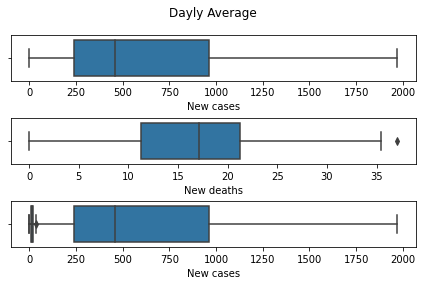

<Figure size 1440x720 with 0 Axes>

In [89]:
# Distribution of dayly averages since January
fig, axes = plt.subplots(3,1)
plt.figure(figsize=(20,10))
#plt.title('Dayly average')


sns.boxplot(ax=axes[0], x=full_grouped_by_date['New cases'])
sns.boxplot(ax=axes[1], x=full_grouped_by_date['New deaths'])
sns.boxplot(ax=axes[2], x=full_grouped_by_date['New deaths'])
sns.boxplot(ax=axes[2], x=full_grouped_by_date['New cases'])
fig.suptitle('Dayly Average')
fig.tight_layout()
fig.subplots_adjust(top=0.88) #3


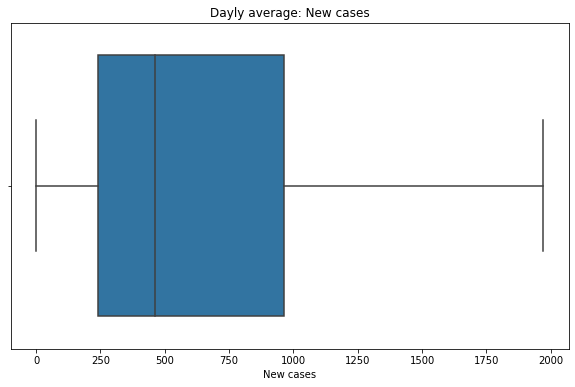

In [90]:
# Distribution of dayly averages since January
plt.figure(figsize=(10,6))
plt.title('Dayly average: New cases')
sns.boxplot(x=full_grouped_by_date['New cases'])

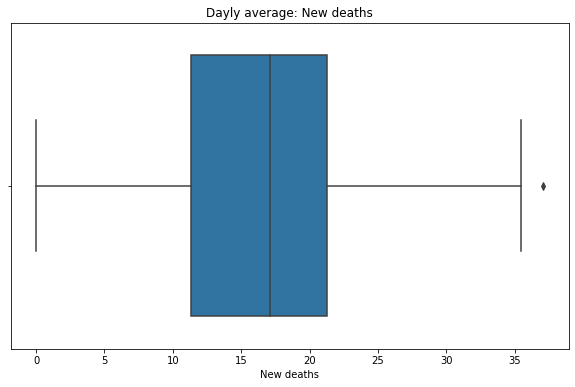

In [91]:
plt.figure(figsize=(10,6))
plt.title('Dayly average: New deaths')
sns.boxplot(x=full_grouped_by_date['New deaths'])

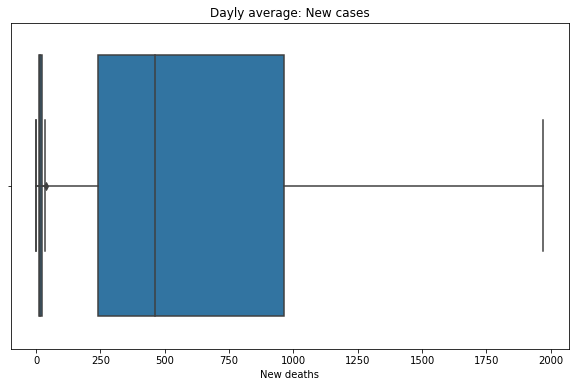

In [92]:
plt.figure(figsize=(10,6))
plt.title('Dayly average: New cases')
sns.boxplot(x=full_grouped_by_date['New cases'])
sns.boxplot(x=full_grouped_by_date['New deaths'])

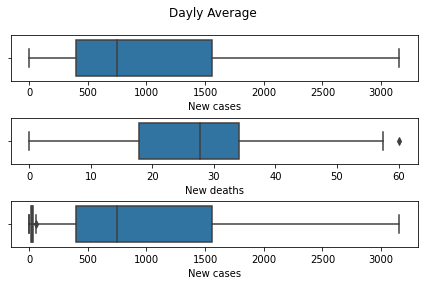

<Figure size 1440x720 with 0 Axes>

In [93]:
# Distribution of dayly averages since January
fig, axes = plt.subplots(3,1)
plt.figure(figsize=(20,10))



sns.boxplot(ax=axes[0], x=full_grouped_by_trend['New cases'])
sns.boxplot(ax=axes[1], x=full_grouped_by_trend['New deaths'])
sns.boxplot(ax=axes[2], x=full_grouped_by_trend['New deaths'])
sns.boxplot(ax=axes[2], x=full_grouped_by_trend['New cases'])
fig.suptitle('Dayly Average')
fig.tight_layout()
fig.subplots_adjust(top=0.88)


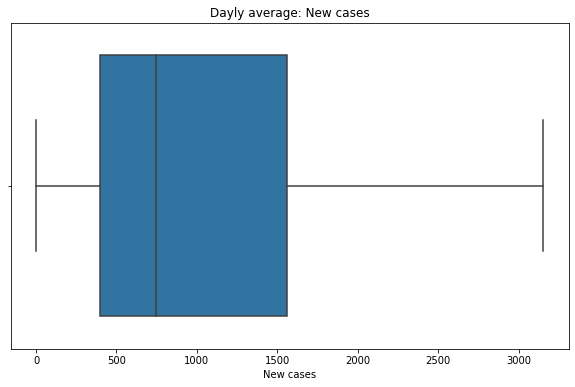

In [94]:
plt.figure(figsize=(10,6))
plt.title('Dayly average: New cases')
sns.boxplot(x=full_grouped_by_trend['New cases'])

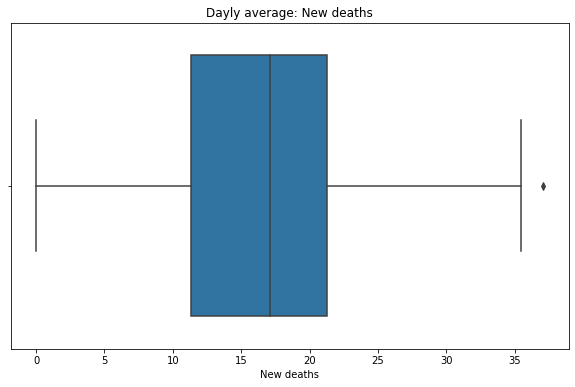

In [95]:
plt.figure(figsize=(10,6))
plt.title('Dayly average: New deaths')
sns.boxplot(x=full_grouped_by_date['New deaths'])

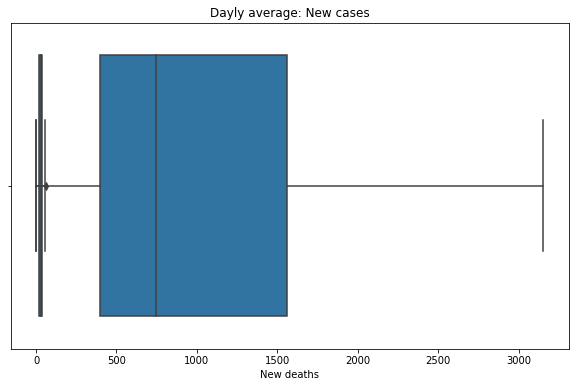

In [96]:
plt.figure(figsize=(10,6))
plt.title('Dayly average: New cases')
sns.boxplot(x=full_grouped_by_trend['New cases'])
sns.boxplot(x=full_grouped_by_trend['New deaths'])

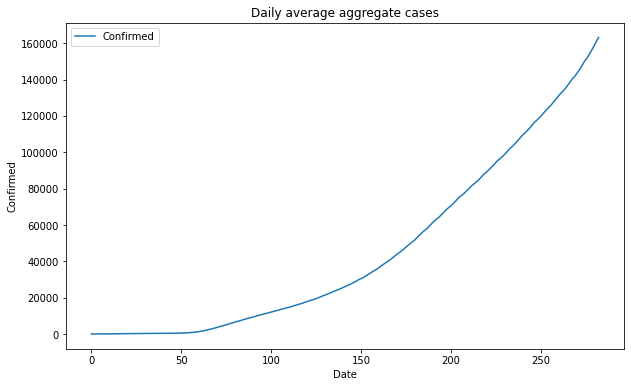

In [97]:
# Confirmed
plt.figure(figsize=(10,6))
full_grouped_by_date['Confirmed'].plot()
plt.title('Daily average aggregate cases')
plt.ylabel('Confirmed')
plt.xlabel('Date')
plt.legend()
plt.show()

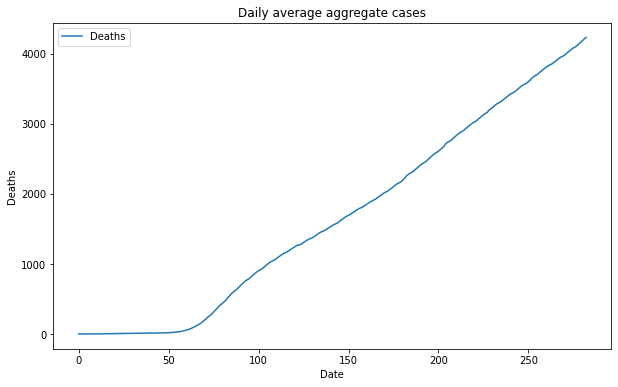

In [98]:
# Deaths
plt.figure(figsize=(10,6))
full_grouped_by_date['Deaths'].plot() 
plt.title('Daily average aggregate cases')
plt.ylabel('Deaths')
plt.xlabel('Date')
plt.legend()
plt.show()

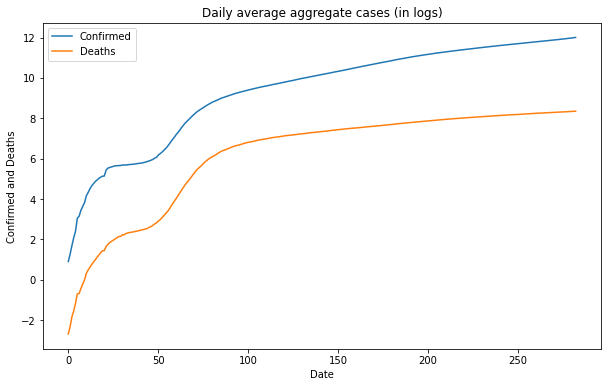

In [99]:
# log
fig = plt.figure(figsize=(10,6))
np.log(full_grouped_by_date['Confirmed']).plot()
np.log(full_grouped_by_date['Deaths']).plot()
plt.title('Daily average aggregate cases (in logs)')
plt.ylabel('Confirmed and Deaths')
plt.xlabel('Date')
plt.legend()
plt.show() #2

La evolución de la media diaria es similar a la evolución del total mundial (en cada período se divide la muestra sobre el número de países del dataframe, que es constante a lo largo del período de análisis). Tanto la evolución linear de casos confirmados y de muertes son similares, sin 

---

embargo la versión logaritmica indica la concavidad de los datos y la existencia de un máximo, que implicaría el control de la epidemia.

### ARGENTINA

In [100]:
# Argentinean Data set
full_grouped_Argentina = full_grouped.groupby('Country/Region').get_group('Argentina')

In [101]:
stats_cases_arg = pd.concat([full_grouped.groupby('Country/Region').get_group('Argentina').describe(),
                                   full_grouped_ix.groupby('Country/Region').get_group('Argentina').describe()],
                                   axis=1, sort=False)

stats_cases_arg = stats_cases_arg.drop(["Lat", "Long", "Confirmed_log", "Deaths_log",
                                        "Population", "index", "trend", "weekdays",
                                        "IncomeGroup_code" ], axis=1) # , "level_0"
stats_cases_arg = stats_cases_arg.drop(["count","min", "25%", "50%", "75%"], axis=0)
print("Daily average for a 'typical (average)' province")
display(stats_cases_arg)
print("Argentinean cases, from the beginning (first four columns) and from the day of the first case (last four columns")


Daily average for a 'typical (average)' province


,Confirmed,Deaths,New cases,New deaths,Infection_rate,Mortality_rate,Confirmed,Deaths,New cases,New deaths,Infection_rate,Mortality_rate
mean,9112.974382,215.311837,171.852915,4.564340,0.202787,0.004791,4.983833e+05,11714.454545,9068.355372,244.743802,11.090289,0.260676
std,44619.847312,1235.754196,645.087165,43.116718,0.992904,0.027499,3.316445e+05,9234.954975,4004.931743,314.039024,7.379929,0.205501
max,549362.000000,17605.000000,7486.000000,3199.000000,12.224694,0.391756,1.166924e+06,30997.000000,18326.000000,3351.000000,25.967010,0.689762


Argentinean cases, from the beginning (first four columns) and from the day of the first case (last four columns


Desde que se observaron casos en Argentina, se han observado, en promedio, cerca a los dos mil casos por día y por provincia. Si tenemos en cuenta que los casos estan concentrados en el AMBA y chaco, los datos son preocupantes para esas provincias. El geomap de la Argentina mostrará estas divergencias más adelante.

## Visualización view

### The World

In [102]:
fig = px.scatter_geo(full_grouped, lat=full_grouped.columns[3], lon=full_grouped.columns[4], 
                     color= full_grouped.columns[5], text=full_grouped.columns[2],
                     hover_name=full_grouped.columns[2], size=full_grouped.columns[5],
                     animation_group=full_grouped.columns[5],
                     projection='natural earth',
                     title='World Confirmed Cases')
fig.show()

In [103]:
fig = px.scatter_geo(full_grouped, lat=full_grouped.columns[3], lon=full_grouped.columns[4], 
                     color= full_grouped.columns[6], text=full_grouped.columns[2],
                     hover_name=full_grouped.columns[2], size=full_grouped.columns[6],
                     animation_group=full_grouped.columns[6],
                     projection='natural earth',
                     title='Covid-19 Deaths around the Globe')
fig.show()

Mientras que los casos de confirmados son resonantes en algunos países como EE.UU, Brazil y Mexico. Los lideres en casos confirmados también son lideres en decesos, sin embargo el mapa de decesos hace más visible los efectos del Covid-19 en otros países, v.g. países Europeos.

Esta regularidad se mantiene en Argentina, al comparar casos confirmados y decesos (ver gráficos debajo).

Si se lográ la ansiada inmunidad comunitaria, antes de la vacuna, los países con más casos mostrarán menos decesos y la regularidad observada entre confirmados y fallecidos resaltará aún más.

In [104]:
fig = px.scatter_geo(full_grouped, lat=full_grouped.columns[3], lon=full_grouped.columns[4], 
                     color= 'Infection_rate', text=full_grouped.columns[2],
                     hover_name=full_grouped.columns[2], size='Infection_rate',
                     animation_group='Infection_rate',
                     projection='natural earth',
                     title='Infection rate per 1000')
fig.show()

In [105]:
fig = px.scatter_geo(full_grouped, lat=full_grouped.columns[3], lon=full_grouped.columns[4], 
                     color= 'Mortality_rate', text=full_grouped.columns[2],
                     hover_name=full_grouped.columns[2], size='Mortality_rate',
                     animation_group='Mortality_rate',
                     projection='natural earth',
                     title='Mortality rate per 1000')
fig.show()

### ARGENTINA

In [1]:
fig = px.scatter_geo(full_grouped_Argentina, lat=full_grouped_Argentina.columns[3], lon=full_grouped_Argentina.columns[4], 
                     color= full_grouped_Argentina.columns[5], text=full_grouped_Argentina.columns[1],
                     hover_name=full_grouped_Argentina.columns[1], size=full_grouped_Argentina.columns[5],
                     animation_group=full_grouped_Argentina.columns[5],
                     scope='south america',
                     center={'lat': -32.14293, 'lon':-63.80175},
                     projection='natural earth',
                     title='Casos confirmados alrededor de Argentina')
fig.show()

NameError: name 'px' is not defined

In [107]:
fig = px.scatter_geo(full_grouped_Argentina, lat=full_grouped_Argentina.columns[3], lon=full_grouped_Argentina.columns[4], 
                     color= full_grouped_Argentina.columns[6], text=full_grouped_Argentina.columns[1],
                     hover_name=full_grouped_Argentina.columns[1], size=full_grouped_Argentina.columns[6],
                     #animation_frame=full_grouped.columns[6],
                     animation_group=full_grouped_Argentina.columns[6],
                     scope='south america',
                     center={'lat': -32.14293, 'lon':-63.80175},
                     projection='natural earth',
                     title='Decesos en Argentina por Covid_19')
fig.show()

In [108]:
#alt.data_transformers.enable('json')
interval = alt.selection_interval()
alt.data_transformers.disable_max_rows() # not using full data (maxrows)
# New cases
circle = alt.Chart(full_grouped_Argentina.tail(5000)).mark_circle().encode(
    x='monthdate(Date):O',
    y=alt.Y('Country/Region', sort='-x'),
    color=alt.condition(interval,
                        'Country/Region', alt.value('lightgray')),
    size=alt.Size('New cases:Q',
        scale=alt.Scale(range=[0, 1000]),
        legend=alt.Legend(title='Daily new cases')
    ) 
).properties(
    width=800,
    height=300,
    selection=interval
)

#
bars= alt.Chart(full_grouped_Argentina.tail(5000)).mark_bar().encode(
    y=alt.Y('Country/Region', sort='-x'),
    color='Country/Region',
    x='sum(New cases):Q'
).properties(
    width=1000).transform_filter(
    interval)
fig=circle & bars
fig

alt.VConcatChart(...)

In [109]:
#alt.data_transformers.enable('json')
interval = alt.selection_interval()
alt.data_transformers.disable_max_rows() # not using full data (maxrows)
# New cases
circle = alt.Chart(full_grouped_Argentina.tail(5000)).mark_circle().encode(
    x='monthdate(Date):O',
    y=alt.Y('Country/Region', sort='-x'),
    color=alt.condition(interval,
                        'Country/Region', alt.value('lightgray')),
    size=alt.Size('New deaths:Q',
        scale=alt.Scale(range=[0, 1000]),
        legend=alt.Legend(title='Daily new cases')
    ) 
).properties(
    width=800,
    height=300,
    selection=interval
)

#
bars= alt.Chart(full_grouped_Argentina.tail(5000)).mark_bar().encode(
    y=alt.Y('Country/Region', sort='-x'),
    color='Country/Region',
    x='sum(New deaths):Q'
).properties(
    width=1000).transform_filter(
    interval)
fig=circle & bars
fig

alt.VConcatChart(...)

### Distribution Plots

In [110]:
def newCases(countries = ['Argentina']):
  plt.figure(figsize=(10, 6))
  for country in countries:
    params = (full_grouped['Country/Region'] == country)
    sns.distplot(full_grouped[params]['New cases'], label=country)
  plt.legend()

def newDeaths(countries = ['Argentina']):
  plt.figure(figsize=(10, 6))
  for country in countries:
    params = (full_grouped['Country/Region'] == country)
    sns.distplot(full_grouped[params]['New deaths'], label=country)
  plt.legend()

def cases_and_deaths(countries = ['Argentina', 'Chile']):
  if len(countries) < 2 or len(countries) > 3:
    return print('Entre 2 o 3 paises')
  fig, axes = plt.subplots(len(countries), 2, figsize=(13, 13))
  sns.despine(left=True)
  row = 0
  for country in countries:
    for column in range(2): 
      params = (full_grouped['Country/Region'] == country)
      if column == 1:
        sns.distplot(full_grouped[params]['New deaths'], ax=axes[row, column])
        axes[row, column].title.set_text('Muertes ' + str(country))
      else:
        sns.distplot(full_grouped[params]['New cases'], ax=axes[row, column])
        axes[row, column].title.set_text('Casos ' + str(country))
      axes[row, column].set_ylabel('')
      axes[row, column].set_xlabel('')
      if column == 1:
          row+=1

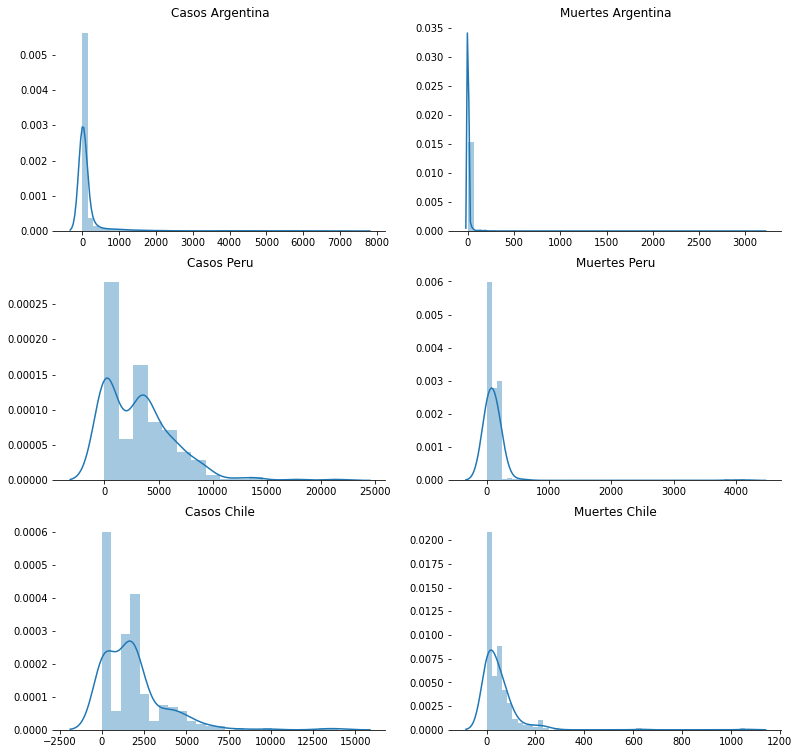

In [111]:
cases_and_deaths(['Argentina', 'Peru', 'Chile'])


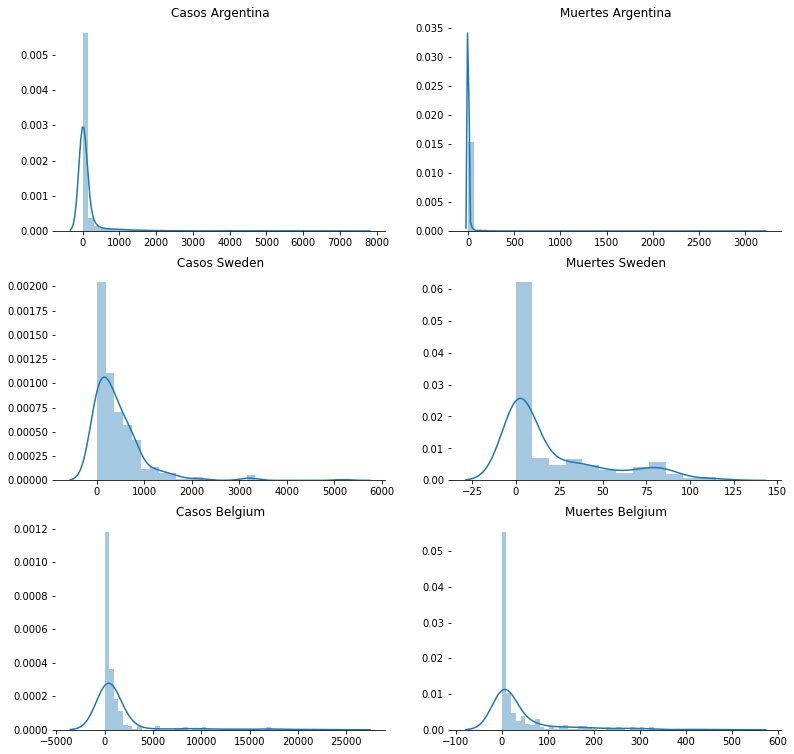

In [112]:
cases_and_deaths(['Argentina', 'Sweden', 'Belgium'])

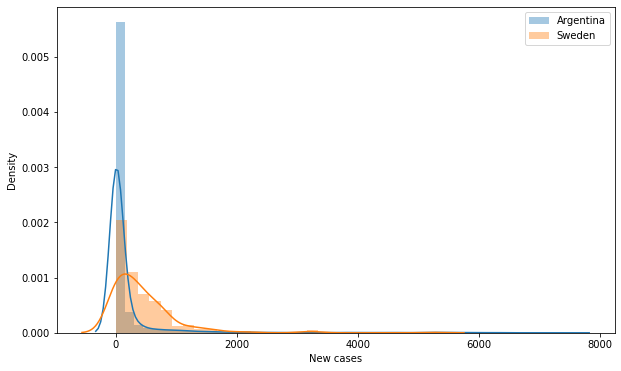

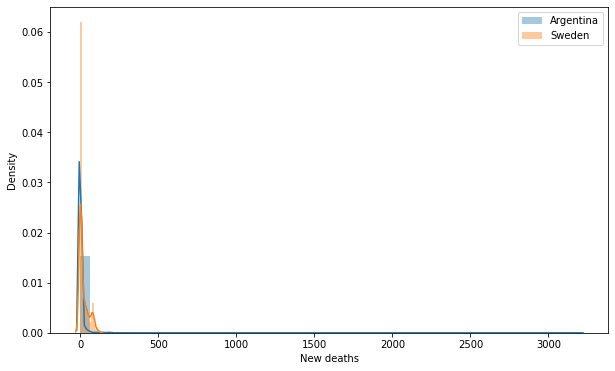

In [113]:
newCases(['Argentina', 'Sweden'])
newDeaths(['Argentina', 'Sweden'])

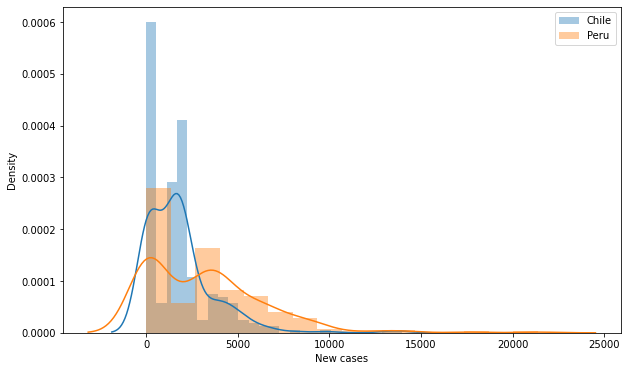

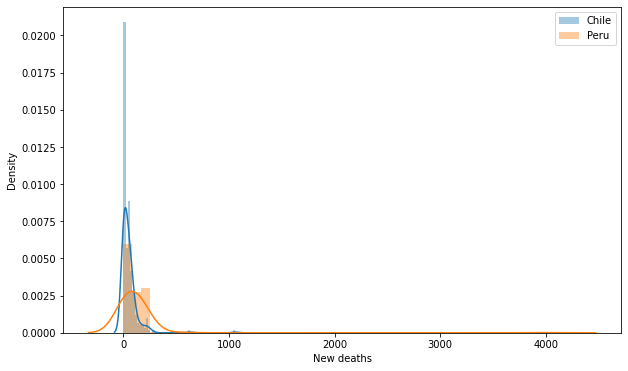

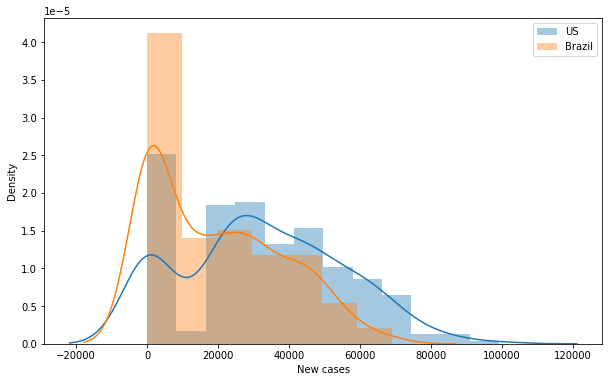

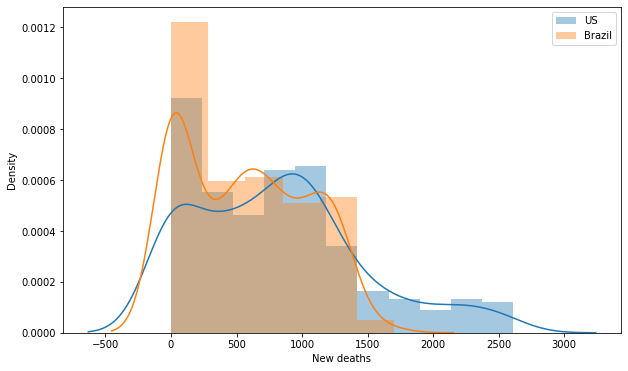

In [114]:
newCases(['Chile', 'Peru'])
newDeaths(['Chile', 'Peru'])
newCases(['US', 'Brazil'])
newDeaths(['US', 'Brazil'])

Al principio todos los países exhiben un pico, luego la tendencia determinará la estructura multimodal o no de cada serie. Refierendonos a los máximos diferentes a los de iniciales, observamos que:
 
En EE. UU. los casos confirmados exhiben dos máximos , mientras que en los casos fallecidos tiene un solo máximo. Perú también tiene dos picos, pero esta regularidad lo manifiesta en los casos de confirmados y fallecidos.

Argentina exhibe solo un máximo en confirmados, pero una regularidad oscilante en el caso de decesos.

### LINEAR & LOG EVOLUTION

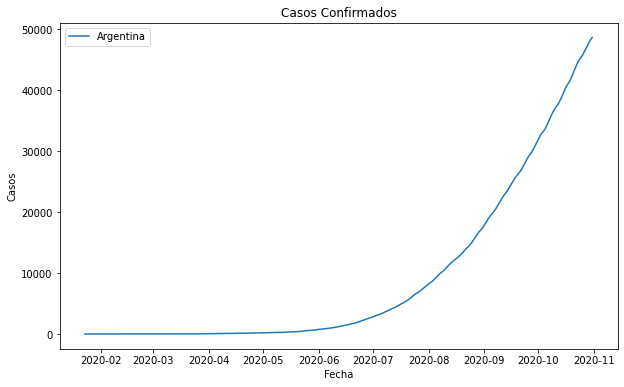

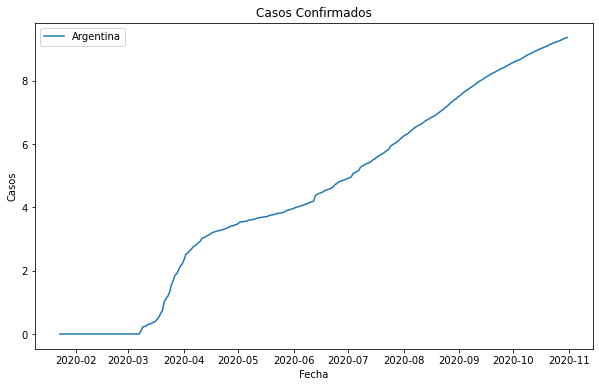

In [115]:
def simpleConfirmedCasesLP(countries = ['Argentina']):
  plt.figure(figsize=(10, 6))
  for country in countries:
    sns.lineplot(full_grouped.Date, full_grouped[full_grouped['Country/Region'] == country]['Confirmed'], label=country)
  plt.title('Casos Confirmados')
  plt.ylabel('Casos')
  plt.xlabel('Fecha')
  plt.legend()
  plt.show()
simpleConfirmedCasesLP()

def simpleConfirmedCasesLog(countries = ['Argentina']):
  plt.figure(figsize=(10, 6))
  for country in countries:
    sns.lineplot(full_grouped.Date, full_grouped[full_grouped['Country/Region'] == country]['Confirmed_log'].fillna(0), label=country)
  plt.title('Casos Confirmados')
  plt.ylabel('Casos')
  plt.xlabel('Fecha')
  plt.legend()
  plt.show()
simpleConfirmedCasesLog()

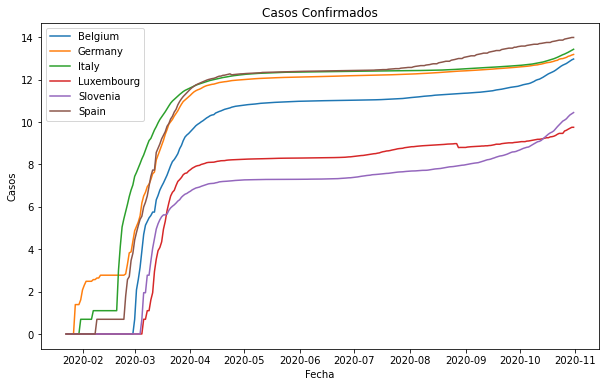

In [116]:
simpleConfirmedCasesLog(['Belgium', 'Germany', 'Italy','Luxembourg', 'Slovenia','Spain'])
#101

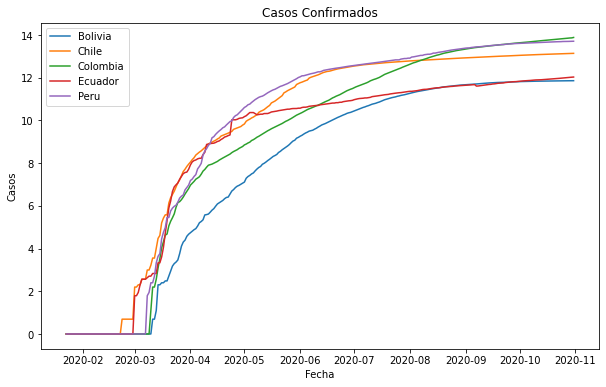

In [117]:
simpleConfirmedCasesLog(['Bolivia', 'Chile', 'Colombia', 'Ecuador', 'Peru'])
#103

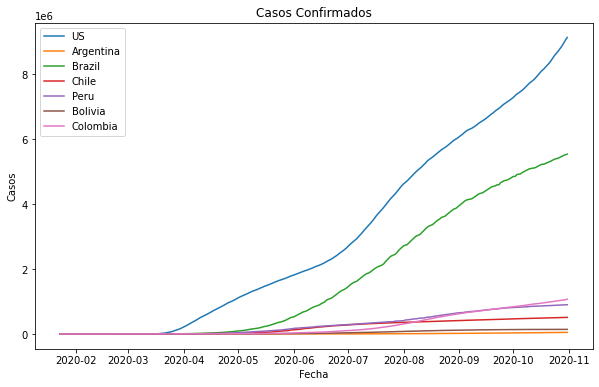

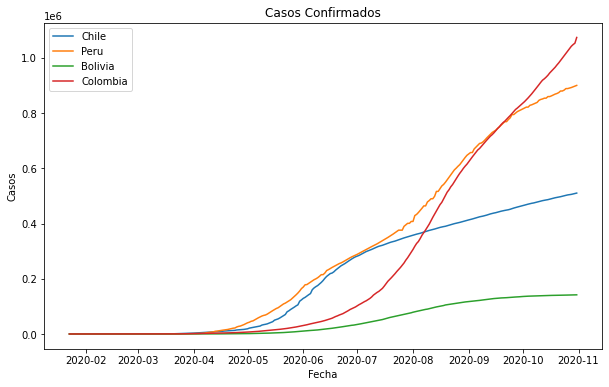

In [118]:
simpleConfirmedCasesLP(['US', 'Argentina', 'Brazil', 'Chile','Peru', 'Bolivia', 'Colombia'])
simpleConfirmedCasesLP(['Chile','Peru', 'Bolivia', 'Colombia'])

In [119]:
# returns a line plot of the countries since the start of the dates

def simpleConfirmedCasesLogSameStart(countries = ['Argentina']):
  plt.figure(figsize=(10, 6))
  for country in countries:
    sns.lineplot(full_grouped_ix.trend, full_grouped_ix[full_grouped_ix['Country/Region'] == country]['Confirmed_log'], label=country)

  plt.title('Casos Confirmados')
  plt.ylabel('Casos')
  plt.xlabel('trend')
  plt.legend()
  plt.show()

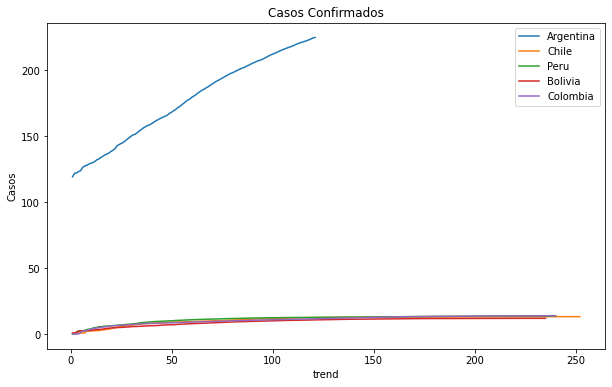

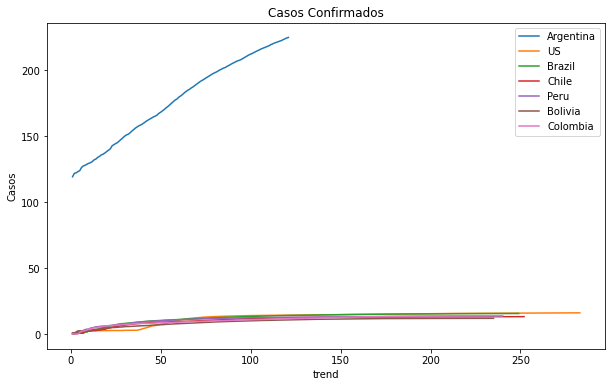

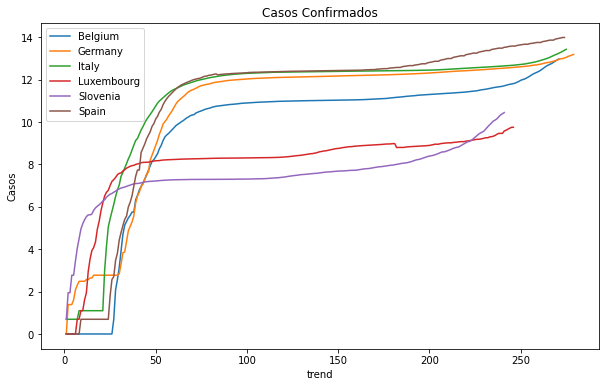

In [120]:
simpleConfirmedCasesLogSameStart(['Argentina', 'Chile','Peru', 'Bolivia', 'Colombia']) 
simpleConfirmedCasesLogSameStart(['Argentina','US', 'Brazil','Chile','Peru', 'Bolivia', 'Colombia'])
# Todos en fase de máximo?
simpleConfirmedCasesLogSameStart(['Belgium', 'Germany', 'Italy','Luxembourg', 'Slovenia','Spain'])
# Slovenia & Luxembourg well positioned. Slovenia does it much better 


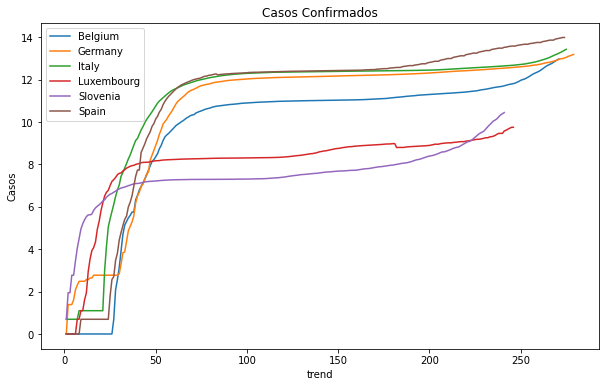

In [121]:
simpleConfirmedCasesLogSameStart(['Belgium', 'Germany', 'Italy','Luxembourg', 'Slovenia','Spain'])
#102

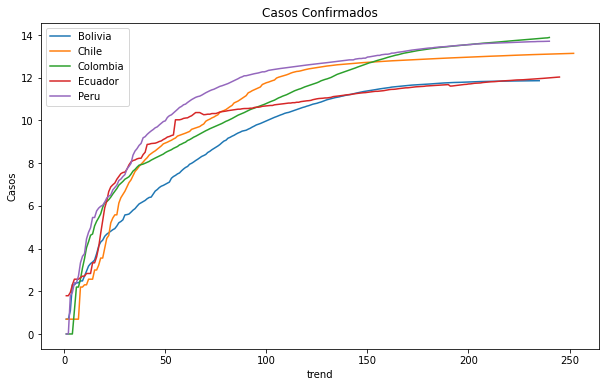

In [122]:
simpleConfirmedCasesLogSameStart(['Bolivia', 'Chile', 'Colombia', 'Ecuador', 'Peru'])
#104


Lo que nos muestra la evolución de los casos confirmados

### ARGENTINA

Text(0, 0.5, 'Casos Confirmados')

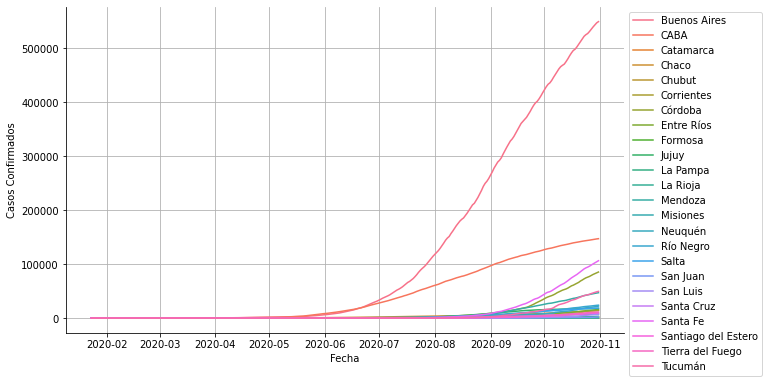

In [123]:
params = (full_grouped['Country/Region'] == 'Argentina')
plt.figure(figsize=(10, 6))
sns.lineplot(full_grouped['Date'], full_grouped[params]['Confirmed'], hue=full_grouped[params]['Province/State'])
plt.legend(bbox_to_anchor=(1, 1, 0, 0))
plt.grid()
sns.despine()
plt.xlabel('Fecha')
plt.ylabel('Casos Confirmados')

Text(0, 0.5, 'Casos Confirmados')

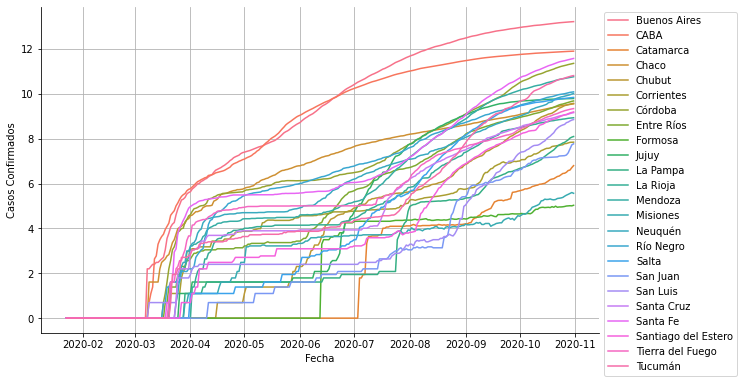

In [124]:
params = (full_grouped['Country/Region'] == 'Argentina')
plt.figure(figsize=(10, 6))
sns.lineplot(full_grouped['Date'], full_grouped[params]['Confirmed_log'].fillna(0), hue=full_grouped[params]['Province/State'])
plt.legend(bbox_to_anchor=(1, 1, 0, 0))
plt.grid()
sns.despine()
plt.xlabel('Fecha')
plt.ylabel('Casos Confirmados')
#105

Text(0, 0.5, 'Decesos')

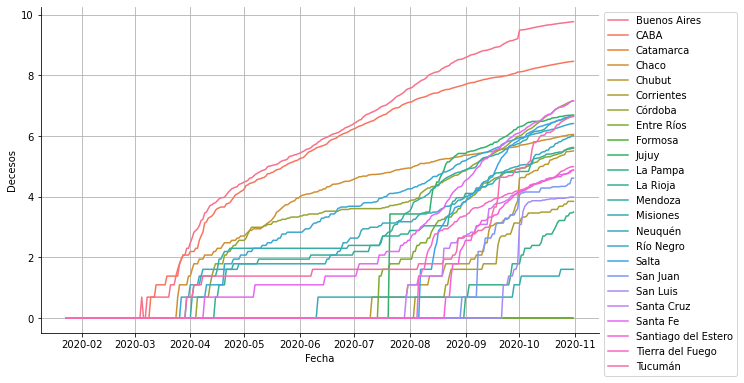

In [125]:
params = (full_grouped['Country/Region'] == 'Argentina')
plt.figure(figsize=(10, 6))
sns.lineplot(full_grouped['Date'], full_grouped[params]['Deaths_log'].fillna(0), hue=full_grouped[params]['Province/State'])
plt.legend(bbox_to_anchor=(1, 1, 0, 0))
plt.grid()
sns.despine()
plt.xlabel('Fecha')
plt.ylabel('Decesos')

In [126]:
params = (full_grouped['Country/Region'] == 'Argentina')
full_grouped[params]['Confirmed'].describe()

count      6792.000000
mean       9112.974382
std       44619.847312
min           0.000000
25%           2.750000
50%          81.000000
75%        1361.750000
max      549362.000000
Name: Confirmed, dtype: float64

In [127]:
provinces_compare = []

arg_params = (full_grouped['Country/Region'] == 'Argentina')

provinces = full_grouped[arg_params]['Province/State'].unique()

# Small Z score, get provinces near mean
zs_confirmed_arg = np.abs((full_grouped[arg_params]['Confirmed'] - full_grouped[arg_params]['Confirmed'].mean())/full_grouped[arg_params]['Confirmed'].std(ddof=0))
close_mean_confirmed_arg = zs_confirmed_arg<0.0025
mean_provinces = full_grouped[arg_params][close_mean_confirmed_arg]['Province/State'].unique()
for province in mean_provinces:
    provinces_compare.append(province) 

if "Córdoba" not in provinces_compare:
  provinces_compare.append("Córdoba")

print("Provincias a comparar: ")
for province in provinces_compare:
    print(province)

Provincias a comparar: 
Buenos Aires
Jujuy
Tucumán
Chaco
Neuquén
Entre Ríos
Chubut
Tierra del Fuego
Santiago del Estero
Santa Cruz
Córdoba


Text(0, 0.5, 'Casos Confirmados')

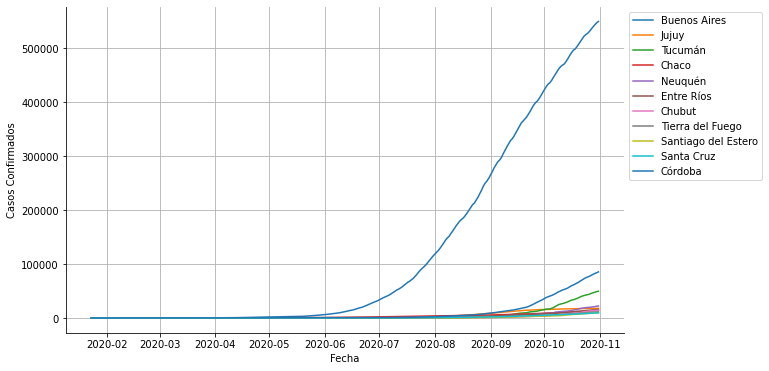

In [128]:
plt.figure(figsize=(10, 6))
for province in provinces_compare:
  params = (full_grouped['Country/Region'] == 'Argentina') & (full_grouped['Province/State'] == province)
  sns.lineplot(full_grouped['Date'], full_grouped[params]['Confirmed'], label=province)
plt.legend(bbox_to_anchor=(1, 1, 0, 0))
plt.grid()
sns.despine()
plt.xlabel('Fecha')
plt.ylabel('Casos Confirmados')

In [ ]:
plt.figure(figsize=(10, 6))
for province in provinces_compare:
  params = (full_grouped['Country/Region'] == 'Argentina') & (full_grouped['Province/State'] == province)
  sns.lineplot(full_grouped['Date'], full_grouped[params]['Deaths'], label=province)
plt.legend(bbox_to_anchor=(1, 1, 0, 0))
plt.grid()
sns.despine()
plt.xlabel('Fecha')
plt.ylabel('Fallecidos')

In [ ]:
litoral =['Formosa', 'Chaco', 'Misiones', 'Corrientes',  'Entre Ríos']
noa=['Jujuy', 'Salta', 'Catamarca', 'La Rioja', 'Tucumán', 'Santiago del Estero']
cuyo=['San Juan', 'Mendoza', 'San Luis']
pampa=['La Pampa', 'Buenos Aires', 'CABA', 'Santa Fe', 'Córdoba']
patagonia=['Neuquén', 'Río Negro', 'Chubut', 'Santa Cruz', 'Tierra del Fuego']

# Argentinean series in logs
def simpleConfirmedCasesLP(provinces = ['Buenos Aires']):
  plt.figure(figsize=(10,6))
  for province in provinces:
    sns.lineplot(full_grouped.Date, full_grouped[full_grouped['Province/State'] == province]['Confirmed_log'].fillna(0), label=province)
 
  plt.title('Confirmed cases (in logs)')
  plt.ylabel('Cases')
  plt.xlabel('Date')
  plt.legend(bbox_to_anchor=(1, 1, 0, 0))
  plt.show()

simpleConfirmedCasesLP()

In [ ]:
simpleConfirmedCasesLP(litoral)

In [ ]:
simpleConfirmedCasesLP(cuyo)

In [ ]:
simpleConfirmedCasesLP(pampa)

In [ ]:
simpleConfirmedCasesLP(patagonia)

In [ ]:
simpleConfirmedCasesLP(['Buenos Aires', 'CABA','Catamarca'])

In [ ]:
simpleConfirmedCasesLP(pampa)
#106

# Seasonal decomposition and Facebook Forecasting Model

## Seasonal decomposition
### Case Model Peru


In [ ]:
def seasonal_descomposition(country = 'Peru'):
  x=full_grouped_ix.groupby('Country/Region').get_group(country)
  x.set_index('Date', inplace=True) # A necessary step to apply seasonal method
  x=x.loc[~(x['Confirmed_log'] == 0)] # In order to apply multiplicative method (trend related to t-1)
  # Applying the seasonal decomposition method
  x_series = seasonal_decompose(x["Confirmed_log"], model='multiplicative')

  fig, (ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(17,16))
  x_series.observed.plot(ax=ax1)
  x_series.trend.plot(ax=ax2)
  x_series.seasonal.plot(ax=ax3)
  x_series.resid.plot(ax=ax4)
seasonal_descomposition()
#107

In [ ]:
seasonal_descomposition('Belgium')

## Applying Facebook Forecasting Method
In order to taking into account up or down jumps and make trends flexible we scale the series as suggested by the Prophet guide (in this case, it is in logs and the scale does not affect much). 


In [ ]:
def ff_method(country = 'Peru'):
  #Creating the DataFrame
  x_Date=full_grouped_ix.groupby('Country/Region').get_group(country).Date # Array
  x_series=full_grouped_ix.groupby('Country/Region').get_group(country).Confirmed_log
  x_dict = {'Date':x_Date,'Confirmed_log':x_series} # Dictionary
  x = pd.DataFrame(x_dict)

  # Preparing data for Prophet
  df_prophet_aux = x
  df_prophet = pd.DataFrame()
  df_prophet['ds'] = df_prophet_aux['Date']
  df_prophet['y'] = df_prophet_aux['Confirmed_log']
  df_prophet.head(10)

  # Applying the Model Prophet per-se
  m = Prophet(seasonality_mode='multiplicative', changepoint_prior_scale=0.5) # the Prophet class (model)
  m.fit(df_prophet) # fit the model using all data
  future_Confirmed_log=m.make_future_dataframe(periods=7, freq='D')
  forecast_Confirmed_log=m.predict(future_Confirmed_log)

  # Picturing it
  m.plot(forecast_Confirmed_log,xlabel='Time',
                              ylabel='Confirmed_log')

  # Scaling to see if the change in trend is correct (trend flexible)
  fig_air=m.plot(forecast_Confirmed_log, xlabel='Time',
                              ylabel='Confirmed_log')
  a=add_changepoints_to_plot(fig_air.gca(),m,forecast_Confirmed_log)

  # Upper and lower bound predicted values
  #display(forecast_Confirmed_log[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head(10))
  benchmarking = pd.concat([x.Confirmed_log.describe(),
                            forecast_Confirmed_log.yhat.describe(),
                            forecast_Confirmed_log.yhat_lower.describe(),
                            forecast_Confirmed_log.yhat_upper.describe()], axis=1, sort=False)

  print('Comparing observed and forecasted values with lower and upper cuts')
  display(benchmarking)

ff_method()

## Death cases, full application

In [ ]:
def full_application(country = 'Peru'):
  # Defining the case country for Death Cases
  y=full_grouped_ix.groupby('Country/Region').get_group(country)
  y.set_index('Date', inplace=True) # A necessary step to apply seasonal method
  # Applying the seasonal decomposition method
  y_series = seasonal_decompose(y["Deaths_log"].dropna(), model='additive') # A goner is a goner

  fig, (ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(17,16))
  y_series.observed.plot(ax=ax1)
  y_series.trend.plot(ax=ax2)
  y_series.seasonal.plot(ax=ax3)
  y_series.resid.plot(ax=ax4)



  #Creating the DataFrame
  x_Date=full_grouped_ix.groupby('Country/Region').get_group(country).Date # Array
  x_series=full_grouped_ix.groupby('Country/Region').get_group(country).Confirmed_log
  x_dict = {'Date':x_Date,'Deaths_log':x_series} # Dictionary
  x = pd.DataFrame(x_dict)

  # Preparing data for Prophet
  df_prophet_aux = x
  df_prophet = pd.DataFrame()
  df_prophet['ds'] = df_prophet_aux['Date']
  df_prophet['y'] = df_prophet_aux['Deaths_log']
  df_prophet.head(10)

  # Applying the Model Prophet per-se
  m = Prophet(seasonality_mode='additive', changepoint_prior_scale=0.5) # the Prophet class (model)
  m.fit(df_prophet) # fit the model using all data
  future_Confirmed_log=m.make_future_dataframe(periods=7, freq='D')
  forecast_Confirmed_log=m.predict(future_Confirmed_log)

  # Picturing it
  m.plot(forecast_Confirmed_log,xlabel='Time',
                              ylabel='Deaths_log')

  # Taking into account up or down jumps
  fig_air=m.plot(forecast_Confirmed_log,xlabel='Time',
                              ylabel='Deaths_log')
  a=add_changepoints_to_plot(fig_air.gca(),m,forecast_Confirmed_log)

full_application()

### Brazil Case

In [ ]:
full_application('Brazil')

In [ ]:
def seasonal_descomposition_results(country = 'Peru'):
  x=full_grouped_ix.groupby('Country/Region').get_group(country)
  x.set_index('Date', inplace=True) # A necessary step to apply seasonal method
  x=x.loc[~(x['Confirmed_log'] == 0)] # In order to apply multiplicative method (trend related to t-1)
  # Applying the seasonal decomposition method
  x_series = seasonal_decompose(x["Confirmed_log"], model='multiplicative')

  return [x_series.trend, x_series.seasonal, x_series.resid]

In [ ]:
len(seasonal_descomposition_results()[0].values) == len(seasonal_descomposition_results()[1].values)

In [ ]:
np.full((1, 5), 7)[0]

# Time Series Clustering

## Organizing the data

In [ ]:
full_grouped_ts = full_grouped.groupby(['Date', 'Country/Region','Province/State']).sum() # We need to avoid double adding

full_grouped_ts = full_grouped_ts.reset_index()
full_grouped_ts.head(3)

In [ ]:
# Relevant data
group_1 = ['Country/Region', 'Lat', 'Long', 'IncomeGroup_code', 'Date', 'Confirmed']
group_2 =['Deaths', 'New cases', 'New deaths', 'weekdays',
          'Population', 'Confirmed_log', 'Deaths_log', 'Infection_rate',
       'Mortality_rate'] # 'Province/State', 'IncomeGroup', 'Region', 'Country Code',
new_cols = group_1+group_2 # Grouping series
set(full_grouped_ts.columns) == set(new_cols) # Setting as columns
full_grouped_cluster = full_grouped_ts[new_cols] # ordering

# drop group 2
full_grouped_cluster.drop(group_2, axis=1, inplace=True)

# Cluster for Monthly data
full_grouped_Monthly = full_grouped_cluster.groupby(['Country/Region',
                                                     'Lat', 'Long',
                                                     'IncomeGroup_code']).resample('M', on='Date').sum()

display(full_grouped_cluster.head(3))
display(full_grouped_Monthly.head(3))

## Applying clustering methods

In [ ]:
# K means Methods: 1: Euclidean, 2: DBA, 3: Soft-DTW

# Applied on the corresponding Variable
X=full_grouped_Monthly
X.drop(['Lat', 'Long', 'IncomeGroup_code'], axis=1, inplace=True)

n_clusters_=5
method_1 = TimeSeriesKMeans(n_clusters=n_clusters_, verbose=True, random_state=42)
method_2 = TimeSeriesKMeans(n_clusters=n_clusters_, n_init=2, metric="dtw",
                          verbose=True, max_iter_barycenter=10,
                          random_state=42)

# First Method
def Dynamic_clustering(method=method_1,
                       reference="Euclidean k-means",
                       dataframe=X,
                       variable='Group_Km'):
  print(reference)
  
  y_pred = method.fit_predict(X)
  dataframe[variable]=y_pred+1

Dynamic_clustering()

# Second Method
Dynamic_clustering(method = method_2,
                   reference="DBA k-means",
                   dataframe=X,
                   variable='Group_DBA_Km')



In [ ]:
full_grouped_Monthly.describe()

## Organizing data for visualization

In [ ]:
full_grouped_Monthly = full_grouped_Monthly.reset_index()
display(full_grouped_Monthly.describe())

def ordinal(method=preprocessing.LabelEncoder(),
            variable=full_grouped_Monthly['Date'],
            variable_1='Date_code'): 
  
  method.fit(variable)

  dict(zip(method.classes_, method.transform(method.classes_)+1))

  #Agregamos una columna con el valor ordinal de la variable considerada
  full_grouped_Monthly[variable_1] = method.transform(variable)+1
ordinal()

In [ ]:

# Identifying cluster memberships along the world
fig = px.scatter_geo(full_grouped_Monthly,
                     lat='Lat', lon='Long', 
                     color= "Group_DBA_Km", text='Group_DBA_Km',
                     hover_name='Country/Region', size='Group_DBA_Km',
                     animation_frame="Date_code",
                     animation_group='Date_code',
                     range_color = [1,5],
                     projection='natural earth',
                     title='World Confirmed Cases')
fig.show()

fig = px.scatter_geo(full_grouped_Monthly, lat='Lat', lon='Long', 
                     color= 'Group_DBA_Km', text='Confirmed',
                     hover_name='Country/Region', size='Group_DBA_Km',
                     animation_frame="Date_code",
                     animation_group='Confirmed',
                     range_color = [1,5],
                     projection='natural earth',
                     title='World Confirmed Cases')
fig.show()

## Applying to New Monthly cases

In [ ]:
# Relevant data
group_1 = ['Country/Region', 'Lat', 'Long', 'IncomeGroup_code', 'Date', 'New cases']
group_2 =['Deaths', 'Confirmed', 'New deaths', 'weekdays',
          'Population', 'Confirmed_log', 'Deaths_log', 'Infection_rate',
       'Mortality_rate'] # 'Province/State', 'IncomeGroup', 'Region', 'Country Code',
new_cols = group_1+group_2 # Grouping series
set(full_grouped_ts.columns) == set(new_cols) # Setting as columns
full_grouped_cluster = full_grouped_ts[new_cols] # ordering

# drop group 2
full_grouped_cluster.drop(group_2, axis=1, inplace=True)

# Cluster for Monthly data
full_grouped_Monthly = full_grouped_cluster.groupby(['Country/Region',
                                                     'Lat', 'Long',
                                                     'IncomeGroup_code']).resample('M', on='Date').sum()

display(full_grouped_cluster.head(3))
display(full_grouped_Monthly.head(3))

In [ ]:
# K means Methods: 1: Euclidean, 2: DBA

# Applied on the corresponding Variable
X=full_grouped_Monthly
X.drop(['Lat', 'Long', 'IncomeGroup_code'], axis=1, inplace=True)

n_clusters_=5
method_1 = TimeSeriesKMeans(n_clusters=n_clusters_, verbose=True, random_state=42)
method_2 = TimeSeriesKMeans(n_clusters=n_clusters_, n_init=2, metric="dtw",
                          verbose=True, max_iter_barycenter=10,
                          random_state=42)

# First Method
def Dynamic_clustering(method=method_1,
                       reference="Euclidean k-means",
                       dataframe=X,
                       variable='Group_Km'):
  print(reference)
  
  y_pred = method.fit_predict(X)
  dataframe[variable]=y_pred+1

Dynamic_clustering()

# Second Method
Dynamic_clustering(method = method_2,
                   reference="DBA k-means",
                   dataframe=X,
                   variable='Group_DBA_Km')



In [ ]:
full_grouped_Monthly = full_grouped_Monthly.reset_index()

In [ ]:
ordinal(variable=full_grouped_Monthly['Date'], variable_1='Date_code')
full_grouped_Monthly.columns

In [ ]:
# Identifying cluster memberships along the world
fig = px.scatter_geo(full_grouped_Monthly,
                     lat='Lat', lon='Long', 
                     color= "Group_DBA_Km", text='Group_DBA_Km',
                     hover_name='Country/Region', size='Group_DBA_Km',
                     animation_frame="Date_code",
                     animation_group='Date_code',
                     range_color = [1,5],
                     projection='natural earth',
                     title='World Monthly Cases')
fig.show()

Thanks